#**Introduction to Clinical DataScience**   
##**Clustering MIMIC data**  


### **Preparing**

I import some standard python data analysis packages and do authentication on Google Drive 

In [2]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999;

<IPython.core.display.Javascript object>

In [1]:
from __future__ import print_function
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from google.colab import auth
from google.cloud import bigquery
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
auth.authenticate_user()
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.preprocessing import StandardScaler,MinMaxScaler
import warnings
warnings.filterwarnings('ignore')
from sklearn.cluster import KMeans

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


Next I will need to enter some information on how to access the data.

*analysis_project* is the project used for processing the queries.

In [2]:
#@title Fill out this form then press [shift ⇧]+[enter ⏎] {run: "auto"}
import subprocess
import re

analysis_project = 'physionet-data-275415'  #@param {type:"string"}
admissions_table = 'physionet-data.mimiciii_clinical.admissions'  # @param {type: "string"}
patients_table = 'physionet-data.mimiciii_clinical.patients'  # @param {type: "string"}
labs_event = 'physionet-data.mimiciii_clinical.labevents'  # @param {type: "string"}
labs_items = 'physionet-data.mimiciii_clinical.d_labitems'  # @param {type: "string"}

# Preprocess queries made with the %%bigquery magic
# by substituting these values
sub_dict = {
    'analysis_project': analysis_project,
    'admissions_table': admissions_table,
    'patients_table': patients_table,
    'ml_table_prefix': analysis_project + '.MIMIC.models_',
    'labs_event':labs_event,
    'labs_items':labs_items
}

# Set the default project for running queries
bigquery.magics.context.project = analysis_project

# Set up the substitution preprocessing injection
# if bigquery.magics._run_query.func_name != 'format_and_run_query':
#   original_run_query = bigquery.magics._run_query
original_run_query = bigquery.magics._run_query
def format_and_run_query(client, query, job_config=None):
  query = query.format(**sub_dict)
  return original_run_query(client, query, job_config)

bigquery.magics._run_query = format_and_run_query

print('analysis_project:', analysis_project)
print()
print('custom %%bigquery magic substitutions:')
for k, v in sub_dict.items():
  print(' ', '{%s}' % k, '→', v)

%config InlineBackend.figure_format = 'svg'
bq = bigquery.Client(project=analysis_project)  

analysis_project: physionet-data-275415

custom %%bigquery magic substitutions:
  {analysis_project} → physionet-data-275415
  {admissions_table} → physionet-data.mimiciii_clinical.admissions
  {patients_table} → physionet-data.mimiciii_clinical.patients
  {ml_table_prefix} → physionet-data-275415.MIMIC.models_
  {labs_event} → physionet-data.mimiciii_clinical.labevents
  {labs_items} → physionet-data.mimiciii_clinical.d_labitems


Create data set named MIMIC

In [3]:
if 'MIMIC' not in [d.dataset_id for d in list(bq.list_datasets())]:
  dataset_id = "{}.MIMIC".format(bq.project)
  dataset = bigquery.Dataset(dataset_id)
  dataset = bq.create_dataset(dataset) 

### **Receiving data**

**In this part I want to get necessary data from MIMIC using BigQuery**

**First of all I got list of Top 40 common labs**

In [4]:
%%bigquery top_labs
SELECT ITEMID,COUNT,LABEL
FROM
(SELECT ITEMID,COUNT(*) AS COUNT
 FROM `{labs_event}`
 GROUP BY (ITEMID))
 JOIN `{labs_items}`
 USING(ITEMID)
 ORDER BY COUNT DESC
 LIMIT 40

In [5]:
top_labs.head()

,ITEMID,COUNT,LABEL
0,51221,881764,Hematocrit
1,50971,845737,Potassium
2,50983,808401,Sodium
3,50912,797389,Creatinine
4,50902,795480,Chloride


 **After this, I wrote query that returned to me DataFrame with requered conditions, namely *lab results from the ﬁrst hour of ICU admission, as well as demographic data including gender, age, admission type, admission location, insurance, marital status, ethnicity*.** 

In [6]:
%%bigquery df_to_cluster
WITH top_labs AS (
SELECT ITEMID,LABEL
FROM
(SELECT ITEMID,COUNT(*) AS COUNT
 FROM `{labs_event}`
 GROUP BY (ITEMID))
 JOIN `{labs_items}`
 USING(ITEMID)
 ORDER BY COUNT DESC
 LIMIT 40 
)

SELECT *EXCEPT(TIME)
FROM
(SELECT SUBJECT_ID,HADM_ID,ADMITTIME,ADMISSION_TYPE,ADMISSION_LOCATION,INSURANCE,MARITAL_STATUS,ETHNICITY,GENDER,
IF(DATETIME_DIFF(ADMITTIME, DOB, DAY)/365.25 < 200,DATETIME_DIFF(ADMITTIME, DOB, DAY)/365.25, 95) AS AGE,ITEMID,CHARTTIME,VALUENUM,
IF(DATETIME_DIFF(CHARTTIME, ADMITTIME, HOUR)<= 1,1,0) AS TIME,HOSPITAL_EXPIRE_FLAG as died,LABEL
FROM
((`{admissions_table}` JOIN `{patients_table}`USING (SUBJECT_ID))
JOIN
(SELECT SUBJECT_ID,HADM_ID,ITEMID,CHARTTIME,VALUENUM
FROM`{labs_event}`)
USING (SUBJECT_ID,HADM_ID))
JOIN
top_labs
USING (ITEMID))
WHERE TIME=1

**Excess information will be deleted later**

In [7]:
df_to_cluster.head(8)

,SUBJECT_ID,HADM_ID,ADMITTIME,ADMISSION_TYPE,ADMISSION_LOCATION,INSURANCE,MARITAL_STATUS,ETHNICITY,GENDER,AGE,ITEMID,CHARTTIME,VALUENUM,died,LABEL
0,1083,188353,2185-08-23 22:04:00,URGENT,TRANSFER FROM HOSP/EXTRAM,Private,None,WHITE,M,37.927447,50960,2185-08-23 21:30:00,1.8,0,Magnesium
1,1802,111237,2188-04-13 08:47:00,EMERGENCY,EMERGENCY ROOM ADMIT,Medicare,DIVORCED,WHITE,M,70.176591,50960,2188-04-13 06:10:00,2.5,0,Magnesium
2,2136,176661,2166-12-25 19:55:00,EMERGENCY,CLINIC REFERRAL/PREMATURE,Medicare,MARRIED,BLACK/AFRICAN AMERICAN,M,66.108145,50960,2166-12-25 14:00:00,1.9,0,Magnesium
3,2365,190337,2178-07-20 17:37:00,EMERGENCY,EMERGENCY ROOM ADMIT,Medicare,SINGLE,WHITE,F,47.676934,50960,2178-07-20 18:36:00,1.7,0,Magnesium
4,3127,157135,2116-05-26 18:00:00,EMERGENCY,EMERGENCY ROOM ADMIT,Medicare,SINGLE,WHITE,M,53.798768,50960,2116-05-26 13:30:00,2.4,0,Magnesium
5,4254,107341,2153-08-30 15:49:00,EMERGENCY,EMERGENCY ROOM ADMIT,Medicare,MARRIED,OTHER,M,81.771389,50960,2153-08-30 14:45:00,2.1,0,Magnesium
6,5270,112684,2109-01-02 13:05:00,EMERGENCY,EMERGENCY ROOM ADMIT,Private,MARRIED,WHITE,M,32.221766,50960,2109-01-02 10:57:00,1.4,0,Magnesium
7,5454,161983,2176-08-10 15:24:00,EMERGENCY,TRANSFER FROM HOSP/EXTRAM,Medicare,WIDOWED,UNKNOWN/NOT SPECIFIED,F,81.086927,50960,2176-08-10 14:58:00,1.9,0,Magnesium


### **Data Preprocessing**

**I want to see if there are cases of repeating the same lab tests in the same HADM ID**

In [8]:
repeated=df_to_cluster.groupby(['HADM_ID','LABEL']).count().reset_index()[['HADM_ID','LABEL','SUBJECT_ID']]
repeated.columns=['HADM_ID','LABEL','Count']
repeated=repeated[repeated['Count']>1].sort_values('Count',ascending=False)
repeated=repeated.groupby(['LABEL','Count']).count().reset_index()
repeated.columns=['Test','Count of repeated tests','Count of admissions']
repeated

,Test,Count of repeated tests,Count of admissions
0,Alanine Aminotransferase (ALT),2,706
1,Alanine Aminotransferase (ALT),3,27
2,Alkaline Phosphatase,2,648
3,Alkaline Phosphatase,3,25
4,Anion Gap,2,3920
...,...,...,...
263,pO2,10,9
264,pO2,11,3
265,pO2,12,1
266,pO2,14,1


Text(0, 0.5, 'Count of admissions')

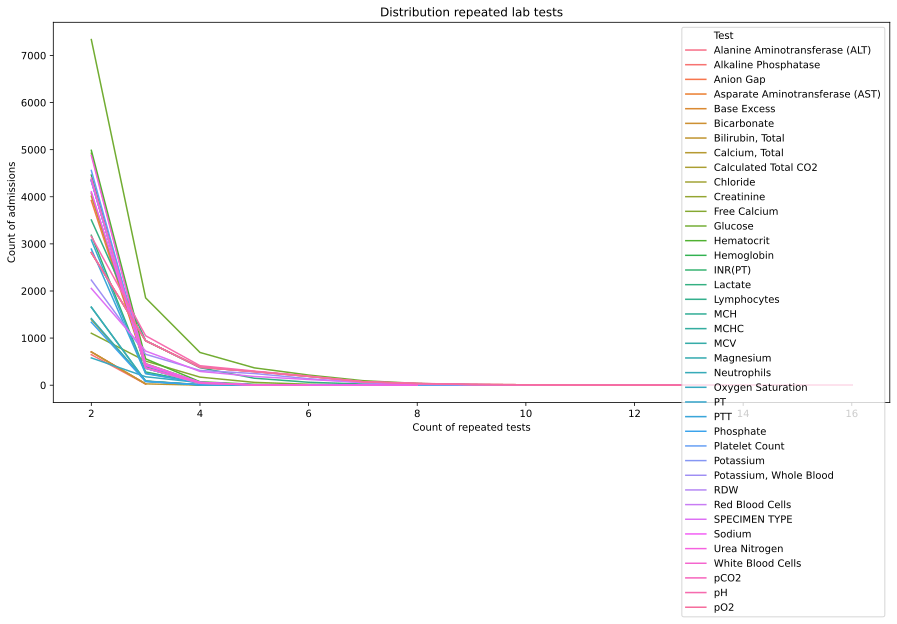

In [9]:
plt.figure(figsize=(15,7))
sns.lineplot(x="Count of repeated tests", y="Count of admissions",
             hue="Test", data=repeated)
plt.title("Distribution repeated lab tests")
plt.xlabel("Count of repeated tests")
plt.ylabel("Count of admissions")

**I decided to take average of repeated tests and drop duplicated rows**

In [10]:
df_to_cluster_new=df_to_cluster.groupby(['HADM_ID','LABEL'])['VALUENUM'].mean().reset_index()
df_to_cluster=df_to_cluster.drop('VALUENUM',axis=1)
df_to_cluster_new=df_to_cluster_new.merge(df_to_cluster,on=['HADM_ID','LABEL'])
df_to_cluster_new=df_to_cluster_new.drop_duplicates()

In [11]:
df_to_cluster_new.head(8)

,HADM_ID,LABEL,VALUENUM,SUBJECT_ID,ADMITTIME,ADMISSION_TYPE,ADMISSION_LOCATION,INSURANCE,MARITAL_STATUS,ETHNICITY,GENDER,AGE,ITEMID,CHARTTIME,died
0,100001,Alanine Aminotransferase (ALT),10.0,58526,2117-09-11 11:46:00,EMERGENCY,CLINIC REFERRAL/PREMATURE,Private,DIVORCED,WHITE,F,35.474333,50861,2117-09-11 08:22:00,0
1,100001,Alkaline Phosphatase,105.0,58526,2117-09-11 11:46:00,EMERGENCY,CLINIC REFERRAL/PREMATURE,Private,DIVORCED,WHITE,F,35.474333,50863,2117-09-11 08:22:00,0
2,100001,Anion Gap,29.0,58526,2117-09-11 11:46:00,EMERGENCY,CLINIC REFERRAL/PREMATURE,Private,DIVORCED,WHITE,F,35.474333,50868,2117-09-11 08:22:00,0
3,100001,Anion Gap,29.0,58526,2117-09-11 11:46:00,EMERGENCY,CLINIC REFERRAL/PREMATURE,Private,DIVORCED,WHITE,F,35.474333,50868,2117-09-11 10:32:00,0
4,100001,Asparate Aminotransferase (AST),16.0,58526,2117-09-11 11:46:00,EMERGENCY,CLINIC REFERRAL/PREMATURE,Private,DIVORCED,WHITE,F,35.474333,50878,2117-09-11 08:22:00,0
5,100001,Bicarbonate,11.5,58526,2117-09-11 11:46:00,EMERGENCY,CLINIC REFERRAL/PREMATURE,Private,DIVORCED,WHITE,F,35.474333,50882,2117-09-11 08:22:00,0
6,100001,Bicarbonate,11.5,58526,2117-09-11 11:46:00,EMERGENCY,CLINIC REFERRAL/PREMATURE,Private,DIVORCED,WHITE,F,35.474333,50882,2117-09-11 10:32:00,0
7,100001,"Bilirubin, Total",0.5,58526,2117-09-11 11:46:00,EMERGENCY,CLINIC REFERRAL/PREMATURE,Private,DIVORCED,WHITE,F,35.474333,50885,2117-09-11 08:22:00,0


**Now DataFrame is ready to apply *pivot_table* and transform column *LABEL***

In [12]:
df_to_clust=df_to_cluster_new.pivot_table(index=['HADM_ID','ADMISSION_TYPE','ADMISSION_LOCATION','INSURANCE','MARITAL_STATUS','ETHNICITY','GENDER','AGE','died'], columns='LABEL', values='VALUENUM').reset_index()
df_to_clust.head(8)

LABEL,HADM_ID,ADMISSION_TYPE,ADMISSION_LOCATION,INSURANCE,MARITAL_STATUS,ETHNICITY,GENDER,AGE,died,Alanine Aminotransferase (ALT),Alkaline Phosphatase,Anion Gap,Asparate Aminotransferase (AST),Base Excess,Bicarbonate,"Bilirubin, Total","Calcium, Total",Calculated Total CO2,Chloride,Creatinine,Free Calcium,Glucose,Hematocrit,Hemoglobin,INR(PT),Lactate,Lymphocytes,MCH,MCHC,MCV,Magnesium,Neutrophils,Oxygen Saturation,PT,PTT,Phosphate,Platelet Count,Potassium,"Potassium, Whole Blood",RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,pCO2,pH,pO2
0,100001,EMERGENCY,CLINIC REFERRAL/PREMATURE,Private,DIVORCED,WHITE,F,35.474333,0,10.0,105.0,29.0,16.0,NaN,11.5,0.5,NaN,NaN,102.5,2.60,NaN,282.5,36.5,13.0,1.0,1.90,9.4,28.40,35.60,80.0,NaN,89.0,NaN,12.1,27.00,NaN,466.0,4.9,NaN,13.6,4.580,138.0,47.0,11.9,NaN,NaN,NaN
1,100003,EMERGENCY,EMERGENCY ROOM ADMIT,Private,SINGLE,WHITE,M,59.909651,0,126.0,157.0,12.0,260.0,NaN,21.0,3.3,NaN,NaN,104.0,1.30,NaN,92.0,26.0,8.5,1.6,NaN,28.8,30.60,32.70,94.0,NaN,61.2,NaN,17.7,34.50,NaN,186.0,5.7,NaN,20.6,2.780,131.0,51.0,17.9,NaN,NaN,NaN
2,100006,EMERGENCY,EMERGENCY ROOM ADMIT,Private,SINGLE,BLACK/AFRICAN AMERICAN,F,48.914442,0,NaN,NaN,19.0,NaN,0.0,24.0,NaN,NaN,26.0,92.0,0.80,NaN,131.0,36.9,12.4,1.3,NaN,5.0,32.30,33.70,96.0,NaN,66.0,NaN,13.9,29.10,NaN,259.0,4.4,NaN,14.8,3.860,131.0,14.0,9.6,40.0,7.41,92.0
3,100007,EMERGENCY,EMERGENCY ROOM ADMIT,Private,MARRIED,WHITE,F,73.820671,0,12.0,89.0,15.0,22.0,NaN,25.0,0.3,NaN,NaN,103.0,0.80,NaN,116.0,36.8,12.2,1.1,3.10,26.4,29.60,33.00,90.0,NaN,68.6,NaN,12.4,21.60,NaN,224.0,3.8,NaN,14.0,4.110,139.0,16.0,7.3,NaN,NaN,NaN
4,100009,EMERGENCY,TRANSFER FROM HOSP/EXTRAM,Private,MARRIED,WHITE,M,60.793977,0,66.0,73.0,13.0,55.0,NaN,25.0,0.3,NaN,NaN,103.0,0.80,NaN,263.0,40.7,14.5,1.1,NaN,NaN,30.80,35.50,87.0,1.9,NaN,NaN,13.2,49.10,NaN,167.0,4.2,NaN,14.2,4.700,137.0,19.0,7.8,NaN,NaN,NaN
5,100011,EMERGENCY,CLINIC REFERRAL/PREMATURE,Medicaid,SINGLE,HISPANIC OR LATINO,M,21.503080,0,NaN,NaN,9.0,NaN,-4.0,24.0,NaN,8.1,24.0,112.0,1.35,1.09,158.5,41.7,14.2,1.4,3.05,10.0,32.25,34.25,94.5,2.0,80.0,NaN,16.0,25.95,5.5,304.5,4.1,4.1,13.3,4.415,141.0,12.0,17.5,52.0,7.25,281.0
6,100016,EMERGENCY,CLINIC REFERRAL/PREMATURE,Medicare,SINGLE,WHITE,M,55.509925,0,NaN,NaN,10.0,NaN,1.0,24.0,NaN,NaN,27.0,107.0,1.00,NaN,69.0,31.6,10.5,1.7,2.00,7.7,37.10,33.40,111.0,NaN,85.5,NaN,18.8,31.40,NaN,162.0,5.0,NaN,18.9,2.840,136.0,54.0,11.7,40.0,7.42,363.0
7,100018,ELECTIVE,PHYS REFERRAL/NORMAL DELI,Private,MARRIED,WHITE,M,55.540041,0,NaN,NaN,14.0,NaN,NaN,28.0,NaN,NaN,NaN,95.0,1.20,NaN,94.0,30.5,9.7,NaN,NaN,NaN,24.90,31.90,78.0,NaN,NaN,NaN,NaN,NaN,NaN,206.0,4.4,NaN,13.6,3.910,133.0,42.0,7.6,NaN,NaN,NaN


**Distribution in categorical columns**  
**I wanted to see what values categorical columns take**

In [13]:
mask_all_df =df_to_clust.dtypes == object
all_df_features=df_to_clust.columns[mask_all_df].tolist()
it=1
for i in all_df_features:
  print('{}) Column:{}\nCount uniques:{}\nNamely: '.format(it,i,len(df_to_clust[i].unique())))
  for ii in df_to_clust[i].unique():
    print('   -{}'.format(ii))
  print('\n')  
  it+=1

1) Column:ADMISSION_TYPE
Count uniques:4
Namely: 
   -EMERGENCY
   -ELECTIVE
   -URGENT
   -NEWBORN


2) Column:ADMISSION_LOCATION
Count uniques:9
Namely: 
   -CLINIC REFERRAL/PREMATURE
   -EMERGENCY ROOM ADMIT
   -TRANSFER FROM HOSP/EXTRAM
   -PHYS REFERRAL/NORMAL DELI
   -TRANSFER FROM SKILLED NUR
   -TRANSFER FROM OTHER HEALT
   -HMO REFERRAL/SICK
   -** INFO NOT AVAILABLE **
   -TRSF WITHIN THIS FACILITY


3) Column:INSURANCE
Count uniques:5
Namely: 
   -Private
   -Medicaid
   -Medicare
   -Government
   -Self Pay


4) Column:MARITAL_STATUS
Count uniques:7
Namely: 
   -DIVORCED
   -SINGLE
   -MARRIED
   -WIDOWED
   -UNKNOWN (DEFAULT)
   -SEPARATED
   -LIFE PARTNER


5) Column:ETHNICITY
Count uniques:41
Namely: 
   -WHITE
   -BLACK/AFRICAN AMERICAN
   -HISPANIC OR LATINO
   -UNKNOWN/NOT SPECIFIED
   -MULTI RACE ETHNICITY
   -WHITE - RUSSIAN
   -OTHER
   -BLACK/CAPE VERDEAN
   -BLACK/HAITIAN
   -UNABLE TO OBTAIN
   -ASIAN
   -HISPANIC/LATINO - SALVADORAN
   -HISPANIC/LATINO - GUATEM

**In this case, I think it is advisable to use the encoder only for the '*GENDER*' column.  
I’ll use OneHot Encoder for other columns, as there are too many values and I don’t have enough information to correctly assign weights.**  
 **I’ll do an additional preprocessing to column *ethnicity* to reduce the variance of the values.**


In [14]:
df_to_clust['ETHNICITY']=df_to_clust['ETHNICITY'].replace(['UNKNOWN/NOT SPECIFIED', 'UNABLE TO OBTAIN','PATIENT DECLINED TO ANSWER'], 'OTHER')
df_to_clust['ETHNICITY']=df_to_clust['ETHNICITY'].replace(['BLACK/AFRICAN AMERICAN'], 'BLACK/AFRICAN')
df_to_clust['ETHNICITY']=df_to_clust['ETHNICITY'].replace(['HISPANIC/LATINO - GUATEMALAN','HISPANIC/LATINO - SALVADORAN','HISPANIC/LATINO - PUERTO RICAN','HISPANIC/LATINO - DOMINICAN','HISPANIC/LATINO - CUBAN',
                                                           'HISPANIC/LATINO - HONDURAN','HISPANIC/LATINO - MEXICAN','HISPANIC/LATINO - CENTRAL AMERICAN (OTHER)',
                                                           'HISPANIC/LATINO - COLOMBIAN','HISPANIC OR LATINO'], 'HISPANIC/LATINO')
df_to_clust['ETHNICITY']=df_to_clust['ETHNICITY'].replace(['ASIAN - CHINESE','ASIAN - ASIAN INDIAN','ASIAN - OTHER','ASIAN - FILIPINO','ASIAN - VIETNAMESE',
                                                           'ASIAN - CAMBODIAN','ASIAN - KOREAN','ASIAN - THAI','ASIAN - JAPANESE'], 'ASIAN')
df_to_clust['ETHNICITY']=df_to_clust['ETHNICITY'].replace(['WHITE - RUSSIAN','WHITE - OTHER EUROPEAN','WHITE - EASTERN EUROPEAN'], 'WHITE')
df_to_clust['ETHNICITY'].unique()

array(['WHITE', 'BLACK/AFRICAN', 'HISPANIC/LATINO', 'OTHER',
       'MULTI RACE ETHNICITY', 'BLACK/CAPE VERDEAN', 'BLACK/HAITIAN',
       'ASIAN', 'WHITE - BRAZILIAN',
       'AMERICAN INDIAN/ALASKA NATIVE FEDERALLY RECOGNIZED TRIBE',
       'PORTUGUESE', 'AMERICAN INDIAN/ALASKA NATIVE', 'MIDDLE EASTERN',
       'CARIBBEAN ISLAND', 'SOUTH AMERICAN',
       'NATIVE HAWAIIAN OR OTHER PACIFIC ISLANDER'], dtype=object)

In [15]:
df_died=df_to_clust[['died']]
df_to_clust=df_to_clust.drop(['HADM_ID','died'],axis=1)
num_columns_mask=df_to_clust.dtypes != object
num_columns = df_to_clust.columns[num_columns_mask].tolist()
df_to_clust['GENDER']=df_to_clust['GENDER'].map({'F':0,'M':1})
df_gender=df_to_clust[['GENDER']]
columns2dummies=['ETHNICITY','MARITAL_STATUS','INSURANCE','ADMISSION_LOCATION','ADMISSION_TYPE']
df_categ=pd.get_dummies(df_to_clust[columns2dummies], prefix='Dummies')
df_numer=df_to_clust[num_columns]

**Next, for the numeric columns I apply MinMax Scaler from SkLearn to achieve better results.**

In [16]:
scaler = MinMaxScaler()
df_numer[df_numer.columns]=scaler.fit_transform(df_numer)
df_numer.head(8)

LABEL,AGE,Alanine Aminotransferase (ALT),Alkaline Phosphatase,Anion Gap,Asparate Aminotransferase (AST),Base Excess,Bicarbonate,"Bilirubin, Total","Calcium, Total",Calculated Total CO2,Chloride,Creatinine,Free Calcium,Glucose,Hematocrit,Hemoglobin,INR(PT),Lactate,Lymphocytes,MCH,MCHC,MCV,Magnesium,Neutrophils,Oxygen Saturation,PT,PTT,Phosphate,Platelet Count,Potassium,"Potassium, Whole Blood",RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,pCO2,pH,pO2
0,0.373414,0.000743,0.021654,0.504673,0.000778,NaN,0.175926,0.006039,NaN,NaN,0.500000,0.060465,NaN,0.209702,0.455581,0.548223,0.008905,0.065844,0.094,0.591667,0.648936,0.567376,NaN,0.898990,NaN,0.065781,0.085020,NaN,0.199567,0.212903,NaN,0.437299,0.510591,0.506024,0.166969,0.014055,NaN,NaN,NaN
1,0.630628,0.009359,0.032915,0.186916,0.012640,NaN,0.351852,0.039855,NaN,NaN,0.518072,0.030233,NaN,0.064171,0.296128,0.319797,0.014248,NaN,0.288,0.637500,0.494681,0.666667,NaN,0.618182,NaN,0.103719,0.135628,NaN,0.078355,0.264516,NaN,0.662379,0.309922,0.421687,0.181488,0.021141,NaN,NaN,NaN
2,0.514889,NaN,NaN,0.317757,NaN,0.940909,0.407407,NaN,NaN,0.419355,0.373494,0.018605,NaN,0.093965,0.461655,0.517766,0.011576,NaN,0.050,0.672917,0.547872,0.680851,NaN,0.666667,NaN,0.077976,0.099190,NaN,0.109957,0.180645,NaN,0.475884,0.430323,0.421687,0.047187,0.011338,0.173684,0.730769,0.118936
3,0.777060,0.000891,0.018190,0.242991,0.001070,NaN,0.425926,0.003623,NaN,NaN,0.506024,0.018605,NaN,0.082506,0.460137,0.507614,0.009795,0.115226,0.264,0.616667,0.510638,0.638298,NaN,0.692929,NaN,0.067814,0.048583,NaN,0.094805,0.141935,NaN,0.450161,0.458194,0.518072,0.054446,0.008622,NaN,NaN,NaN
4,0.639937,0.004902,0.014725,0.205607,0.002674,NaN,0.425926,0.003623,NaN,NaN,0.506024,0.018605,NaN,0.194805,0.519362,0.624365,0.009795,NaN,NaN,0.641667,0.643617,0.617021,0.055749,NaN,NaN,0.073234,0.234143,NaN,0.070130,0.167742,NaN,0.456592,0.523969,0.493976,0.065336,0.009212,NaN,NaN,NaN
5,0.226348,NaN,NaN,0.130841,NaN,0.931818,0.407407,NaN,0.213287,0.387097,0.614458,0.031395,0.268293,0.114973,0.534548,0.609137,0.012467,0.113169,0.100,0.671875,0.577128,0.670213,0.059233,0.808081,NaN,0.092202,0.077935,0.256039,0.129654,0.161290,0.028751,0.427653,0.492196,0.542169,0.039927,0.020668,0.236842,0.576923,0.414710
6,0.584315,NaN,NaN,0.149533,NaN,0.943182,0.407407,NaN,NaN,0.435484,0.554217,0.023256,NaN,0.046600,0.381169,0.421320,0.015138,0.069959,0.077,0.772917,0.531915,0.787234,NaN,0.863636,NaN,0.111171,0.114710,NaN,0.067965,0.219355,NaN,0.607717,0.316611,0.481928,0.192377,0.013818,0.173684,0.740385,0.543036
7,0.584632,NaN,NaN,0.224299,NaN,NaN,0.481481,NaN,NaN,NaN,0.409639,0.027907,NaN,0.065699,0.364465,0.380711,NaN,NaN,NaN,0.518750,0.452128,0.553191,NaN,NaN,NaN,NaN,NaN,NaN,0.087013,0.180645,NaN,0.437299,0.435897,0.445783,0.148820,0.008976,NaN,NaN,NaN


**Now all values take values from 0 to 1**

In [17]:
df_numer.describe()

LABEL,AGE,Alanine Aminotransferase (ALT),Alkaline Phosphatase,Anion Gap,Asparate Aminotransferase (AST),Base Excess,Bicarbonate,"Bilirubin, Total","Calcium, Total",Calculated Total CO2,Chloride,Creatinine,Free Calcium,Glucose,Hematocrit,Hemoglobin,INR(PT),Lactate,Lymphocytes,MCH,MCHC,MCV,Magnesium,Neutrophils,Oxygen Saturation,PT,PTT,Phosphate,Platelet Count,Potassium,"Potassium, Whole Blood",RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,pCO2,pH,pO2
count,39813.000000,16503.000000,15994.000000,32665.000000,16486.000000,13216.000000,32922.000000,16142.000000,18107.000000,13214.000000,32993.000000,35229.000000,7639.000000,37848.000000,35650.000000,35439.000000,29745.000000,18564.000000,27597.000000,35400.000000,35412.000000,35400.000000,18394.000000,27597.000000,4214.000000,29686.000000,29012.000000,17691.000000,35608.000000,32879.000000,13413.000000,35339.000000,35402.000000,32857.000000,35186.000000,35488.000000,13213.000000,14223.000000,13211.000000
mean,0.673782,0.007587,0.027705,0.263651,0.006854,0.938045,0.412477,0.019098,0.234442,0.408204,0.493614,0.037635,0.278661,0.110073,0.435295,0.488760,0.014167,0.088645,0.152048,0.629871,0.540863,0.639233,0.058851,0.770434,0.893420,0.094441,0.131811,0.174351,0.107321,0.176938,0.030933,0.482969,0.438208,0.504999,0.101610,0.013959,0.194856,0.674620,0.311294
std,0.193031,0.040731,0.035231,0.083859,0.037304,0.017919,0.095879,0.047788,0.035814,0.103743,0.077695,0.041827,0.040261,0.067896,0.101359,0.120094,0.016662,0.075907,0.117776,0.057842,0.088498,0.052042,0.016840,0.150004,0.126386,0.065486,0.134742,0.076205,0.055166,0.055665,0.011713,0.070684,0.088230,0.063958,0.084385,0.013910,0.073346,0.099695,0.219375
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.552008,0.001263,0.013642,0.205607,0.001021,0.932955,0.361111,0.004831,0.216783,0.354839,0.445783,0.018605,0.261324,0.074102,0.369021,0.406091,0.009795,0.045267,0.070000,0.600000,0.485372,0.609929,0.048780,0.703030,0.852632,0.069169,0.070850,0.130435,0.073593,0.141935,0.026056,0.432476,0.379041,0.469880,0.050817,0.008504,0.154386,0.625000,0.117371
50%,0.690630,0.001931,0.018839,0.242991,0.001653,0.940909,0.407407,0.007246,0.237762,0.408602,0.493976,0.025581,0.282230,0.090909,0.438117,0.492386,0.010686,0.065844,0.122000,0.633333,0.547872,0.638298,0.059233,0.803030,0.947368,0.075943,0.094467,0.159420,0.099567,0.167742,0.029650,0.463023,0.440357,0.506024,0.072595,0.011929,0.182456,0.692308,0.248826
75%,0.821672,0.003714,0.028584,0.299065,0.003354,0.945455,0.462963,0.013285,0.255245,0.451613,0.542169,0.037209,0.299652,0.119939,0.504176,0.573604,0.013357,0.106996,0.203000,0.662500,0.601064,0.666667,0.066202,0.876768,0.978947,0.090848,0.132928,0.198068,0.131169,0.200000,0.034591,0.517685,0.498328,0.542169,0.123412,0.016744,0.215789,0.740385,0.496088
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


**Collect all parts of the data frame into one**

In [18]:
final_df=pd.concat([df_died, df_gender,df_numer,df_categ],axis=1) 
final_df.head(8)

,died,GENDER,AGE,Alanine Aminotransferase (ALT),Alkaline Phosphatase,Anion Gap,Asparate Aminotransferase (AST),Base Excess,Bicarbonate,"Bilirubin, Total","Calcium, Total",Calculated Total CO2,Chloride,Creatinine,Free Calcium,Glucose,Hematocrit,Hemoglobin,INR(PT),Lactate,Lymphocytes,MCH,MCHC,MCV,Magnesium,Neutrophils,Oxygen Saturation,PT,PTT,Phosphate,Platelet Count,Potassium,"Potassium, Whole Blood",RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,pCO2,pH,...,Dummies_AMERICAN INDIAN/ALASKA NATIVE FEDERALLY RECOGNIZED TRIBE,Dummies_ASIAN,Dummies_BLACK/AFRICAN,Dummies_BLACK/CAPE VERDEAN,Dummies_BLACK/HAITIAN,Dummies_CARIBBEAN ISLAND,Dummies_HISPANIC/LATINO,Dummies_MIDDLE EASTERN,Dummies_MULTI RACE ETHNICITY,Dummies_NATIVE HAWAIIAN OR OTHER PACIFIC ISLANDER,Dummies_OTHER,Dummies_PORTUGUESE,Dummies_SOUTH AMERICAN,Dummies_WHITE,Dummies_WHITE - BRAZILIAN,Dummies_DIVORCED,Dummies_LIFE PARTNER,Dummies_MARRIED,Dummies_SEPARATED,Dummies_SINGLE,Dummies_UNKNOWN (DEFAULT),Dummies_WIDOWED,Dummies_Government,Dummies_Medicaid,Dummies_Medicare,Dummies_Private,Dummies_Self Pay,Dummies_** INFO NOT AVAILABLE **,Dummies_CLINIC REFERRAL/PREMATURE,Dummies_EMERGENCY ROOM ADMIT,Dummies_HMO REFERRAL/SICK,Dummies_PHYS REFERRAL/NORMAL DELI,Dummies_TRANSFER FROM HOSP/EXTRAM,Dummies_TRANSFER FROM OTHER HEALT,Dummies_TRANSFER FROM SKILLED NUR,Dummies_TRSF WITHIN THIS FACILITY,Dummies_ELECTIVE,Dummies_EMERGENCY,Dummies_NEWBORN,Dummies_URGENT
0,0,0,0.373414,0.000743,0.021654,0.504673,0.000778,NaN,0.175926,0.006039,NaN,NaN,0.500000,0.060465,NaN,0.209702,0.455581,0.548223,0.008905,0.065844,0.094,0.591667,0.648936,0.567376,NaN,0.898990,NaN,0.065781,0.085020,NaN,0.199567,0.212903,NaN,0.437299,0.510591,0.506024,0.166969,0.014055,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
1,0,1,0.630628,0.009359,0.032915,0.186916,0.012640,NaN,0.351852,0.039855,NaN,NaN,0.518072,0.030233,NaN,0.064171,0.296128,0.319797,0.014248,NaN,0.288,0.637500,0.494681,0.666667,NaN,0.618182,NaN,0.103719,0.135628,NaN,0.078355,0.264516,NaN,0.662379,0.309922,0.421687,0.181488,0.021141,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
2,0,0,0.514889,NaN,NaN,0.317757,NaN,0.940909,0.407407,NaN,NaN,0.419355,0.373494,0.018605,NaN,0.093965,0.461655,0.517766,0.011576,NaN,0.050,0.672917,0.547872,0.680851,NaN,0.666667,NaN,0.077976,0.099190,NaN,0.109957,0.180645,NaN,0.475884,0.430323,0.421687,0.047187,0.011338,0.173684,0.730769,...,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
3,0,0,0.777060,0.000891,0.018190,0.242991,0.001070,NaN,0.425926,0.003623,NaN,NaN,0.506024,0.018605,NaN,0.082506,0.460137,0.507614,0.009795,0.115226,0.264,0.616667,0.510638,0.638298,NaN,0.692929,NaN,0.067814,0.048583,NaN,0.094805,0.141935,NaN,0.450161,0.458194,0.518072,0.054446,0.008622,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
4,0,1,0.639937,0.004902,0.014725,0.205607,0.002674,NaN,0.425926,0.003623,NaN,NaN,0.506024,0.018605,NaN,0.194805,0.519362,0.624365,0.009795,NaN,NaN,0.641667,0.643617,0.617021,0.055749,NaN,NaN,0.073234,0.234143,NaN,0.070130,0.167742,NaN,0.456592,0.523969,0.493976,0.065336,0.009212,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0
5,0,1,0.226348,NaN,NaN,0.130841,NaN,0.931818,0.407407,NaN,0.213287,0.387097,0.614458,0.031395,0.268293,0.114973,0.534548,0.609137,0.012467,0.113169,0.100,0.671875,0.577128,0.670213,0.059233,0.808081,NaN,0.092202,0.077935,0.256039,0.129654,0.161290,0.028751,0.427653,0.492196,0.542169,0.039927,0.020668,0.236842,0.576923,...,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0
6,0,1,0.584315,NaN,NaN,0.149533,NaN,0.943182,0.407407,NaN,NaN,0.435484,0.554217,0.023256,NaN,0.046600,0.381169,0.421320,0.015138,0.069959,0.077,0.772917,0.531915,0.787234,NaN,0.863636,NaN,0.111171,0.114710,NaN,0.067965,0.219355,NaN,0.607717,0.316611,0.481928,0.192377,0.0138

 **And replace Nan to '*-1*'**

In [19]:
final_df=final_df.fillna(-1)
final_df.head(8)

,died,GENDER,AGE,Alanine Aminotransferase (ALT),Alkaline Phosphatase,Anion Gap,Asparate Aminotransferase (AST),Base Excess,Bicarbonate,"Bilirubin, Total","Calcium, Total",Calculated Total CO2,Chloride,Creatinine,Free Calcium,Glucose,Hematocrit,Hemoglobin,INR(PT),Lactate,Lymphocytes,MCH,MCHC,MCV,Magnesium,Neutrophils,Oxygen Saturation,PT,PTT,Phosphate,Platelet Count,Potassium,"Potassium, Whole Blood",RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,pCO2,pH,...,Dummies_AMERICAN INDIAN/ALASKA NATIVE FEDERALLY RECOGNIZED TRIBE,Dummies_ASIAN,Dummies_BLACK/AFRICAN,Dummies_BLACK/CAPE VERDEAN,Dummies_BLACK/HAITIAN,Dummies_CARIBBEAN ISLAND,Dummies_HISPANIC/LATINO,Dummies_MIDDLE EASTERN,Dummies_MULTI RACE ETHNICITY,Dummies_NATIVE HAWAIIAN OR OTHER PACIFIC ISLANDER,Dummies_OTHER,Dummies_PORTUGUESE,Dummies_SOUTH AMERICAN,Dummies_WHITE,Dummies_WHITE - BRAZILIAN,Dummies_DIVORCED,Dummies_LIFE PARTNER,Dummies_MARRIED,Dummies_SEPARATED,Dummies_SINGLE,Dummies_UNKNOWN (DEFAULT),Dummies_WIDOWED,Dummies_Government,Dummies_Medicaid,Dummies_Medicare,Dummies_Private,Dummies_Self Pay,Dummies_** INFO NOT AVAILABLE **,Dummies_CLINIC REFERRAL/PREMATURE,Dummies_EMERGENCY ROOM ADMIT,Dummies_HMO REFERRAL/SICK,Dummies_PHYS REFERRAL/NORMAL DELI,Dummies_TRANSFER FROM HOSP/EXTRAM,Dummies_TRANSFER FROM OTHER HEALT,Dummies_TRANSFER FROM SKILLED NUR,Dummies_TRSF WITHIN THIS FACILITY,Dummies_ELECTIVE,Dummies_EMERGENCY,Dummies_NEWBORN,Dummies_URGENT
0,0,0,0.373414,0.000743,0.021654,0.504673,0.000778,-1.000000,0.175926,0.006039,-1.000000,-1.000000,0.500000,0.060465,-1.000000,0.209702,0.455581,0.548223,0.008905,0.065844,0.094,0.591667,0.648936,0.567376,-1.000000,0.898990,-1.0,0.065781,0.085020,-1.000000,0.199567,0.212903,-1.000000,0.437299,0.510591,0.506024,0.166969,0.014055,-1.000000,-1.000000,...,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
1,0,1,0.630628,0.009359,0.032915,0.186916,0.012640,-1.000000,0.351852,0.039855,-1.000000,-1.000000,0.518072,0.030233,-1.000000,0.064171,0.296128,0.319797,0.014248,-1.000000,0.288,0.637500,0.494681,0.666667,-1.000000,0.618182,-1.0,0.103719,0.135628,-1.000000,0.078355,0.264516,-1.000000,0.662379,0.309922,0.421687,0.181488,0.021141,-1.000000,-1.000000,...,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
2,0,0,0.514889,-1.000000,-1.000000,0.317757,-1.000000,0.940909,0.407407,-1.000000,-1.000000,0.419355,0.373494,0.018605,-1.000000,0.093965,0.461655,0.517766,0.011576,-1.000000,0.050,0.672917,0.547872,0.680851,-1.000000,0.666667,-1.0,0.077976,0.099190,-1.000000,0.109957,0.180645,-1.000000,0.475884,0.430323,0.421687,0.047187,0.011338,0.173684,0.730769,...,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
3,0,0,0.777060,0.000891,0.018190,0.242991,0.001070,-1.000000,0.425926,0.003623,-1.000000,-1.000000,0.506024,0.018605,-1.000000,0.082506,0.460137,0.507614,0.009795,0.115226,0.264,0.616667,0.510638,0.638298,-1.000000,0.692929,-1.0,0.067814,0.048583,-1.000000,0.094805,0.141935,-1.000000,0.450161,0.458194,0.518072,0.054446,0.008622,-1.000000,-1.000000,...,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
4,0,1,0.639937,0.004902,0.014725,0.205607,0.002674,-1.000000,0.425926,0.003623,-1.000000,-1.000000,0.506024,0.018605,-1.000000,0.194805,0.519362,0.624365,0.009795,-1.000000,-1.000,0.641667,0.643617,0.617021,0.055749,-1.000000,-1.0,0.073234,0.234143,-1.000000,0.070130,0.167742,-1.000000,0.456592,0.523969,0.493976,0.065336,0.009212,-1.000000,-1.000000,...,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0
5,0,1,0.226348,-1.000000,-1.000000,0.130841,-1.000000,0.931818,0.407407,-1.000000,0.213287,0.387097,0.614458,0.031395,0.268293,0.114973,0.534548,0.609137,0.012467,0.113169,0.100,0.671875,0.577128,0.670213,0.059233,0.808081,-1.0,0.092202,0.077935,0.256039,0.129654,0.161290,0.028751,0.427653,0.492196,0.542169,0.039927,0.020668,0.236842,0.576923,...,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0

**Finnaly step for clustering is to drop column '*died*'**

In [20]:
df4cluster=final_df.drop('died',axis=1)
target=final_df['died']

### **Clustering**

**First of all I want to see death probability and death distribution**

In [21]:
print('Numbers of class 0 (not died):{}\nNumbers of class 1 (died):{}\nDeath probability:{:.3f}%'.format(target.value_counts()[0],target.value_counts()[1],100*target.value_counts()[1]/target.value_counts()[0]))

Numbers of class 0 (not died):35255
Numbers of class 1 (died):4558
Death probability:12.929%


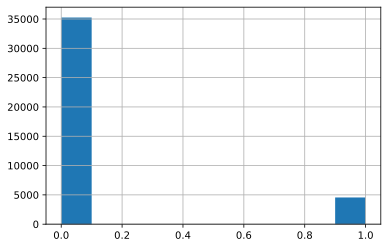

In [22]:
target.hist()

**Before clustering, visualize the data using TSNE**

In [23]:
tsne = TSNE(learning_rate=50)
tsne_features = tsne.fit_transform(df4cluster)

In [24]:
df_subset=pd.DataFrame()
df_subset['tsne-2d-one'] = tsne_features[:,0]
df_subset['tsne-2d-two'] = tsne_features[:,1]
df_subset['y'] = target
flatui = ["#efe6f2", "#fd1336"]
plt.figure(figsize=(12,8))
sns.scatterplot(
    x="tsne-2d-one", y="tsne-2d-two",
    hue="y",
    palette=sns.color_palette(flatui),
    data=df_subset,
    legend="full",
    alpha=0.3
)


**I see that the data is very mixed**

In [25]:
pca = PCA(n_components=2)
pca_result = pca.fit_transform(df4cluster)
df_subset=pd.DataFrame()
df_subset['pca-one'] = pca_result[:,0]
df_subset['pca-two'] = pca_result[:,1]
df_subset['y'] = target

In [26]:
plt.figure(figsize=(12,8))
sns.scatterplot(
    x="pca-one", y="pca-two",
    hue="y",
    palette=sns.color_palette(flatui),
    data=df_subset,
    legend="full",
    alpha=0.3
)

**Using PCA, I see two clusters, but the death targets in them is still scattered**

**Lets fit k-means model with 4 clusters**

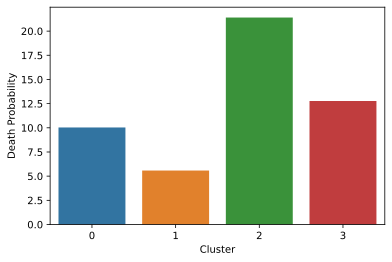

,Cluster,Class 0,Class 1,Probability
0,0,12809,1285,10.032009
1,1,3959,221,5.582218
2,2,7998,1712,21.405351
3,3,10489,1340,12.775288


In [27]:
model = KMeans(n_clusters=4)
labels = model.fit_predict(df4cluster)
df = pd.DataFrame({'labels': labels, 'targets': target})
ct = pd.crosstab(df['labels'],df['targets'])
ct=ct.reset_index()
ct.columns=['Cluster','Class 0','Class 1']
ct['Probability']=100*ct['Class 1']/ct['Class 0']
sns.barplot(y='Probability', x='Cluster',data=ct)
plt.ylabel("Death Probability")
plt.show()
display(ct)

 **Distribution into 4 clusters allowed us to single out the cluster with the highest mortality rate - 21% versus 12% without clustering.
Two clusters with lower mortality of 5 and 10 percent are also distinguished, the probability of death in them is also lower than without clustering.**

**In this case, clustering allows us to improve the prediction of the probability of death.**

### **Optimization**

**First of all I used dimensional reduction PCA with 2 components and applied after this clustering model**

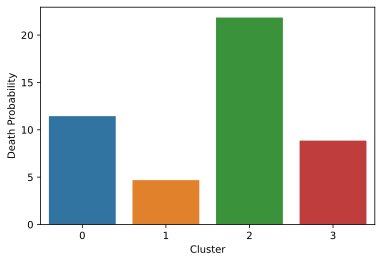

,Cluster,Class 0,Class 1,Probability
0,0,21709,2484,11.442259
1,1,3504,164,4.680365
2,2,7852,1716,21.854305
3,3,2190,194,8.858447


In [28]:
pca = PCA(n_components=2)
pca_result = pca.fit_transform(df4cluster)
model = KMeans(n_clusters=4)
labels = model.fit_predict(pca_result)
df = pd.DataFrame({'labels': labels, 'targets': target})
ct = pd.crosstab(df['labels'],df['targets'])
ct=ct.reset_index()
ct.columns=['Cluster','Class 0','Class 1']
ct['Probability']=100*ct['Class 1']/ct['Class 0']
sns.barplot(y='Probability', x='Cluster',data=ct)
plt.ylabel("Death Probability")
plt.show()
display(ct)


**Using the pca to optimize the clustering, it seems to me, allowed us to get improvements. Namely, we were able to slightly increase the probability of death in the cluster with the highest rate, and in the other three clusters, on the contrary, reduce it. Thus, we have improved our separation ability.**

**After this I wrote a function that will allow me to compare different conditions**  
**I can set the number of laboratory tests and also use categorical features or not**  
**The exception is gender. It is present in all cases.** 

In [29]:
def fast_query(lab=20,cat=True,clust=4):
  labs=top_labs['LABEL'].tolist()[:lab]
  df_to_cluster_1=df_to_cluster_new[df_to_cluster_new['LABEL'].isin(labs)]
  df_to_cluster_1=df_to_cluster_1.pivot_table(index=['HADM_ID','ADMISSION_TYPE','ADMISSION_LOCATION','INSURANCE','MARITAL_STATUS','ETHNICITY','GENDER','AGE','died'], columns='LABEL', values='VALUENUM').reset_index()
  df_to_cluster_1['ETHNICITY']=df_to_cluster_1['ETHNICITY'].replace(['UNKNOWN/NOT SPECIFIED', 'UNABLE TO OBTAIN','PATIENT DECLINED TO ANSWER'], 'OTHER')
  df_to_cluster_1['ETHNICITY']=df_to_cluster_1['ETHNICITY'].replace(['BLACK/AFRICAN AMERICAN'], 'BLACK/AFRICAN')
  df_to_cluster_1['ETHNICITY']=df_to_cluster_1['ETHNICITY'].replace(['HISPANIC/LATINO - GUATEMALAN','HISPANIC/LATINO - SALVADORAN','HISPANIC/LATINO - PUERTO RICAN','HISPANIC/LATINO - DOMINICAN','HISPANIC/LATINO - CUBAN',
                                                            'HISPANIC/LATINO - HONDURAN','HISPANIC/LATINO - MEXICAN','HISPANIC/LATINO - CENTRAL AMERICAN (OTHER)',
                                                            'HISPANIC/LATINO - COLOMBIAN','HISPANIC OR LATINO'], 'HISPANIC/LATINO')
  df_to_cluster_1['ETHNICITY']=df_to_cluster_1['ETHNICITY'].replace(['ASIAN - CHINESE','ASIAN - ASIAN INDIAN','ASIAN - OTHER','ASIAN - FILIPINO','ASIAN - VIETNAMESE',
                                                            'ASIAN - CAMBODIAN','ASIAN - KOREAN','ASIAN - THAI','ASIAN - JAPANESE'], 'ASIAN')
  df_to_cluster_1['ETHNICITY']=df_to_cluster_1['ETHNICITY'].replace(['WHITE - RUSSIAN','WHITE - OTHER EUROPEAN','WHITE - EASTERN EUROPEAN'], 'WHITE')

  df_died=df_to_cluster_1[['died']]
  df_to_cluster_1=df_to_cluster_1.drop(['HADM_ID','died'],axis=1)
  num_columns_mask=df_to_cluster_1.dtypes != object
  num_columns = df_to_cluster_1.columns[num_columns_mask].tolist()
  df_to_cluster_1['GENDER']=df_to_cluster_1['GENDER'].map({'F':0,'M':1})
  df_gender=df_to_cluster_1[['GENDER']]
  columns2dummies=['ETHNICITY','MARITAL_STATUS','INSURANCE','ADMISSION_LOCATION','ADMISSION_TYPE']
  df_categ=pd.get_dummies(df_to_cluster_1[columns2dummies], prefix='Dummies')
  df_numer=df_to_cluster_1[num_columns]
  scaler = MinMaxScaler()
  df_numer[df_numer.columns]=scaler.fit_transform(df_numer)
  if cat==True:
    final_df=pd.concat([df_died, df_gender,df_numer,df_categ],axis=1)
  else:
    final_df=pd.concat([df_died, df_gender,df_numer],axis=1)
  final_df=final_df.fillna(-1)
  df4cluster=final_df.drop('died',axis=1)
  target=final_df['died']
  model = KMeans(n_clusters=clust)
  labels = model.fit_predict(df4cluster)
  df = pd.DataFrame({'labels': labels, 'targets': target})
  ct = pd.crosstab(df['labels'],df['targets'])
  ct=ct.reset_index()
  ct.columns=['Cluster','Class 0','Class 1']
  ct['Probability']=100*ct['Class 1']/ct['Class 0']
  if cat==True:
    print('DataFrame with categorical features')
  else:
    print('DataFrame without categorical features')
  display(df4cluster.head(3))
  print('\nNumber clusters=',clust)
  display(ct)
  print('\n\n')
    

**I want to consider the following cases**  
**- Without categorical features - number of labs 40**  
**- Without categorical features - number of labs 20**  
**- Without categorical features - number of labs 10**  
**- With categorical features - number of labs 20**  
**- With categorical features - number of labs 10**  
  
**For each case considered the number of clusters from 2 to 6**  


In [30]:
cases=[(False,40),(False,20),(False,10),(True,20),(True,10)]
clusters=[2,3,4,5,6]
for cat,labs in cases:
  for cl in clusters:
    print('Categorical features: {}'.format(cat))
    print('Number lab tests: {}'.format(labs))
    print('Number clusters: {}'.format(cl))
    fast_query(cat=cat,lab=labs,clust=cl) 
    print('_____________________________________________________\n\n') 
    

Categorical features: False
Number lab tests: 40
Number clusters: 2
DataFrame without categorical features


LABEL,GENDER,AGE,Alanine Aminotransferase (ALT),Alkaline Phosphatase,Anion Gap,Asparate Aminotransferase (AST),Base Excess,Bicarbonate,"Bilirubin, Total","Calcium, Total",Calculated Total CO2,Chloride,Creatinine,Free Calcium,Glucose,Hematocrit,Hemoglobin,INR(PT),Lactate,Lymphocytes,MCH,MCHC,MCV,Magnesium,Neutrophils,Oxygen Saturation,PT,PTT,Phosphate,Platelet Count,Potassium,"Potassium, Whole Blood",RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,pCO2,pH,pO2
0,0,0.373414,0.000743,0.021654,0.504673,0.000778,-1.000000,0.175926,0.006039,-1.0,-1.000000,0.500000,0.060465,-1.0,0.209702,0.455581,0.548223,0.008905,0.065844,0.094,0.591667,0.648936,0.567376,-1.0,0.898990,-1.0,0.065781,0.085020,-1.0,0.199567,0.212903,-1.0,0.437299,0.510591,0.506024,0.166969,0.014055,-1.000000,-1.000000,-1.000000
1,1,0.630628,0.009359,0.032915,0.186916,0.012640,-1.000000,0.351852,0.039855,-1.0,-1.000000,0.518072,0.030233,-1.0,0.064171,0.296128,0.319797,0.014248,-1.000000,0.288,0.637500,0.494681,0.666667,-1.0,0.618182,-1.0,0.103719,0.135628,-1.0,0.078355,0.264516,-1.0,0.662379,0.309922,0.421687,0.181488,0.021141,-1.000000,-1.000000,-1.000000
2,0,0.514889,-1.000000,-1.000000,0.317757,-1.000000,0.940909,0.407407,-1.000000,-1.0,0.419355,0.373494,0.018605,-1.0,0.093965,0.461655,0.517766,0.011576,-1.000000,0.050,0.672917,0.547872,0.680851,-1.0,0.666667,-1.0,0.077976,0.099190,-1.0,0.109957,0.180645,-1.0,0.475884,0.430323,0.421687,0.047187,0.011338,0.173684,0.730769,0.118936



Number clusters= 2


,Cluster,Class 0,Class 1,Probability
0,0,30107,4166,13.837314
1,1,5148,392,7.614608





_____________________________________________________


Categorical features: False
Number lab tests: 40
Number clusters: 3
DataFrame without categorical features


LABEL,GENDER,AGE,Alanine Aminotransferase (ALT),Alkaline Phosphatase,Anion Gap,Asparate Aminotransferase (AST),Base Excess,Bicarbonate,"Bilirubin, Total","Calcium, Total",Calculated Total CO2,Chloride,Creatinine,Free Calcium,Glucose,Hematocrit,Hemoglobin,INR(PT),Lactate,Lymphocytes,MCH,MCHC,MCV,Magnesium,Neutrophils,Oxygen Saturation,PT,PTT,Phosphate,Platelet Count,Potassium,"Potassium, Whole Blood",RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,pCO2,pH,pO2
0,0,0.373414,0.000743,0.021654,0.504673,0.000778,-1.000000,0.175926,0.006039,-1.0,-1.000000,0.500000,0.060465,-1.0,0.209702,0.455581,0.548223,0.008905,0.065844,0.094,0.591667,0.648936,0.567376,-1.0,0.898990,-1.0,0.065781,0.085020,-1.0,0.199567,0.212903,-1.0,0.437299,0.510591,0.506024,0.166969,0.014055,-1.000000,-1.000000,-1.000000
1,1,0.630628,0.009359,0.032915,0.186916,0.012640,-1.000000,0.351852,0.039855,-1.0,-1.000000,0.518072,0.030233,-1.0,0.064171,0.296128,0.319797,0.014248,-1.000000,0.288,0.637500,0.494681,0.666667,-1.0,0.618182,-1.0,0.103719,0.135628,-1.0,0.078355,0.264516,-1.0,0.662379,0.309922,0.421687,0.181488,0.021141,-1.000000,-1.000000,-1.000000
2,0,0.514889,-1.000000,-1.000000,0.317757,-1.000000,0.940909,0.407407,-1.000000,-1.0,0.419355,0.373494,0.018605,-1.0,0.093965,0.461655,0.517766,0.011576,-1.000000,0.050,0.672917,0.547872,0.680851,-1.0,0.666667,-1.0,0.077976,0.099190,-1.0,0.109957,0.180645,-1.0,0.475884,0.430323,0.421687,0.047187,0.011338,0.173684,0.730769,0.118936



Number clusters= 3


,Cluster,Class 0,Class 1,Probability
0,0,23234,2619,11.272273
1,1,4012,228,5.682951
2,2,8009,1711,21.363466





_____________________________________________________


Categorical features: False
Number lab tests: 40
Number clusters: 4
DataFrame without categorical features


LABEL,GENDER,AGE,Alanine Aminotransferase (ALT),Alkaline Phosphatase,Anion Gap,Asparate Aminotransferase (AST),Base Excess,Bicarbonate,"Bilirubin, Total","Calcium, Total",Calculated Total CO2,Chloride,Creatinine,Free Calcium,Glucose,Hematocrit,Hemoglobin,INR(PT),Lactate,Lymphocytes,MCH,MCHC,MCV,Magnesium,Neutrophils,Oxygen Saturation,PT,PTT,Phosphate,Platelet Count,Potassium,"Potassium, Whole Blood",RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,pCO2,pH,pO2
0,0,0.373414,0.000743,0.021654,0.504673,0.000778,-1.000000,0.175926,0.006039,-1.0,-1.000000,0.500000,0.060465,-1.0,0.209702,0.455581,0.548223,0.008905,0.065844,0.094,0.591667,0.648936,0.567376,-1.0,0.898990,-1.0,0.065781,0.085020,-1.0,0.199567,0.212903,-1.0,0.437299,0.510591,0.506024,0.166969,0.014055,-1.000000,-1.000000,-1.000000
1,1,0.630628,0.009359,0.032915,0.186916,0.012640,-1.000000,0.351852,0.039855,-1.0,-1.000000,0.518072,0.030233,-1.0,0.064171,0.296128,0.319797,0.014248,-1.000000,0.288,0.637500,0.494681,0.666667,-1.0,0.618182,-1.0,0.103719,0.135628,-1.0,0.078355,0.264516,-1.0,0.662379,0.309922,0.421687,0.181488,0.021141,-1.000000,-1.000000,-1.000000
2,0,0.514889,-1.000000,-1.000000,0.317757,-1.000000,0.940909,0.407407,-1.000000,-1.0,0.419355,0.373494,0.018605,-1.0,0.093965,0.461655,0.517766,0.011576,-1.000000,0.050,0.672917,0.547872,0.680851,-1.0,0.666667,-1.0,0.077976,0.099190,-1.0,0.109957,0.180645,-1.0,0.475884,0.430323,0.421687,0.047187,0.011338,0.173684,0.730769,0.118936



Number clusters= 4


,Cluster,Class 0,Class 1,Probability
0,0,8009,1711,21.363466
1,1,12782,1281,10.021906
2,2,3987,227,5.693504
3,3,10477,1339,12.780376





_____________________________________________________


Categorical features: False
Number lab tests: 40
Number clusters: 5
DataFrame without categorical features


LABEL,GENDER,AGE,Alanine Aminotransferase (ALT),Alkaline Phosphatase,Anion Gap,Asparate Aminotransferase (AST),Base Excess,Bicarbonate,"Bilirubin, Total","Calcium, Total",Calculated Total CO2,Chloride,Creatinine,Free Calcium,Glucose,Hematocrit,Hemoglobin,INR(PT),Lactate,Lymphocytes,MCH,MCHC,MCV,Magnesium,Neutrophils,Oxygen Saturation,PT,PTT,Phosphate,Platelet Count,Potassium,"Potassium, Whole Blood",RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,pCO2,pH,pO2
0,0,0.373414,0.000743,0.021654,0.504673,0.000778,-1.000000,0.175926,0.006039,-1.0,-1.000000,0.500000,0.060465,-1.0,0.209702,0.455581,0.548223,0.008905,0.065844,0.094,0.591667,0.648936,0.567376,-1.0,0.898990,-1.0,0.065781,0.085020,-1.0,0.199567,0.212903,-1.0,0.437299,0.510591,0.506024,0.166969,0.014055,-1.000000,-1.000000,-1.000000
1,1,0.630628,0.009359,0.032915,0.186916,0.012640,-1.000000,0.351852,0.039855,-1.0,-1.000000,0.518072,0.030233,-1.0,0.064171,0.296128,0.319797,0.014248,-1.000000,0.288,0.637500,0.494681,0.666667,-1.0,0.618182,-1.0,0.103719,0.135628,-1.0,0.078355,0.264516,-1.0,0.662379,0.309922,0.421687,0.181488,0.021141,-1.000000,-1.000000,-1.000000
2,0,0.514889,-1.000000,-1.000000,0.317757,-1.000000,0.940909,0.407407,-1.000000,-1.0,0.419355,0.373494,0.018605,-1.0,0.093965,0.461655,0.517766,0.011576,-1.000000,0.050,0.672917,0.547872,0.680851,-1.0,0.666667,-1.0,0.077976,0.099190,-1.0,0.109957,0.180645,-1.0,0.475884,0.430323,0.421687,0.047187,0.011338,0.173684,0.730769,0.118936



Number clusters= 5


,Cluster,Class 0,Class 1,Probability
0,0,6830,1534,22.459736
1,1,11076,1484,13.398339
2,2,3988,227,5.692076
3,3,10721,1012,9.439418
4,4,2640,301,11.401515





_____________________________________________________


Categorical features: False
Number lab tests: 40
Number clusters: 6
DataFrame without categorical features


LABEL,GENDER,AGE,Alanine Aminotransferase (ALT),Alkaline Phosphatase,Anion Gap,Asparate Aminotransferase (AST),Base Excess,Bicarbonate,"Bilirubin, Total","Calcium, Total",Calculated Total CO2,Chloride,Creatinine,Free Calcium,Glucose,Hematocrit,Hemoglobin,INR(PT),Lactate,Lymphocytes,MCH,MCHC,MCV,Magnesium,Neutrophils,Oxygen Saturation,PT,PTT,Phosphate,Platelet Count,Potassium,"Potassium, Whole Blood",RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,pCO2,pH,pO2
0,0,0.373414,0.000743,0.021654,0.504673,0.000778,-1.000000,0.175926,0.006039,-1.0,-1.000000,0.500000,0.060465,-1.0,0.209702,0.455581,0.548223,0.008905,0.065844,0.094,0.591667,0.648936,0.567376,-1.0,0.898990,-1.0,0.065781,0.085020,-1.0,0.199567,0.212903,-1.0,0.437299,0.510591,0.506024,0.166969,0.014055,-1.000000,-1.000000,-1.000000
1,1,0.630628,0.009359,0.032915,0.186916,0.012640,-1.000000,0.351852,0.039855,-1.0,-1.000000,0.518072,0.030233,-1.0,0.064171,0.296128,0.319797,0.014248,-1.000000,0.288,0.637500,0.494681,0.666667,-1.0,0.618182,-1.0,0.103719,0.135628,-1.0,0.078355,0.264516,-1.0,0.662379,0.309922,0.421687,0.181488,0.021141,-1.000000,-1.000000,-1.000000
2,0,0.514889,-1.000000,-1.000000,0.317757,-1.000000,0.940909,0.407407,-1.000000,-1.0,0.419355,0.373494,0.018605,-1.0,0.093965,0.461655,0.517766,0.011576,-1.000000,0.050,0.672917,0.547872,0.680851,-1.0,0.666667,-1.0,0.077976,0.099190,-1.0,0.109957,0.180645,-1.0,0.475884,0.430323,0.421687,0.047187,0.011338,0.173684,0.730769,0.118936



Number clusters= 6


,Cluster,Class 0,Class 1,Probability
0,0,6579,981,14.911081
1,1,3964,222,5.600404
2,2,10551,995,9.430386
3,3,6830,1534,22.459736
4,4,4698,525,11.174968
5,5,2633,301,11.431827





_____________________________________________________


Categorical features: False
Number lab tests: 20
Number clusters: 2
DataFrame without categorical features


LABEL,GENDER,AGE,Anion Gap,Bicarbonate,"Calcium, Total",Chloride,Creatinine,Glucose,Hematocrit,Hemoglobin,MCH,MCHC,MCV,Magnesium,Phosphate,Platelet Count,Potassium,RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells
0,0,0.373414,0.504673,0.175926,-1.0,0.500000,0.060465,0.209702,0.455581,0.548223,0.591667,0.648936,0.567376,-1.0,-1.0,0.199567,0.212903,0.437299,0.510591,0.506024,0.166969,0.014055
1,1,0.630628,0.186916,0.351852,-1.0,0.518072,0.030233,0.064171,0.296128,0.319797,0.637500,0.494681,0.666667,-1.0,-1.0,0.078355,0.264516,0.662379,0.309922,0.421687,0.181488,0.021141
2,0,0.514889,0.317757,0.407407,-1.0,0.373494,0.018605,0.093965,0.461655,0.517766,0.672917,0.547872,0.680851,-1.0,-1.0,0.109957,0.180645,0.475884,0.430323,0.421687,0.047187,0.011338



Number clusters= 2


,Cluster,Class 0,Class 1,Probability
0,0,31137,4316,13.861323
1,1,3393,143,4.214559





_____________________________________________________


Categorical features: False
Number lab tests: 20
Number clusters: 3
DataFrame without categorical features


LABEL,GENDER,AGE,Anion Gap,Bicarbonate,"Calcium, Total",Chloride,Creatinine,Glucose,Hematocrit,Hemoglobin,MCH,MCHC,MCV,Magnesium,Phosphate,Platelet Count,Potassium,RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells
0,0,0.373414,0.504673,0.175926,-1.0,0.500000,0.060465,0.209702,0.455581,0.548223,0.591667,0.648936,0.567376,-1.0,-1.0,0.199567,0.212903,0.437299,0.510591,0.506024,0.166969,0.014055
1,1,0.630628,0.186916,0.351852,-1.0,0.518072,0.030233,0.064171,0.296128,0.319797,0.637500,0.494681,0.666667,-1.0,-1.0,0.078355,0.264516,0.662379,0.309922,0.421687,0.181488,0.021141
2,0,0.514889,0.317757,0.407407,-1.0,0.373494,0.018605,0.093965,0.461655,0.517766,0.672917,0.547872,0.680851,-1.0,-1.0,0.109957,0.180645,0.475884,0.430323,0.421687,0.047187,0.011338



Number clusters= 3


,Cluster,Class 0,Class 1,Probability
0,0,15217,2593,17.040152
1,1,3388,142,4.191263
2,2,15925,1724,10.825746





_____________________________________________________


Categorical features: False
Number lab tests: 20
Number clusters: 4
DataFrame without categorical features


LABEL,GENDER,AGE,Anion Gap,Bicarbonate,"Calcium, Total",Chloride,Creatinine,Glucose,Hematocrit,Hemoglobin,MCH,MCHC,MCV,Magnesium,Phosphate,Platelet Count,Potassium,RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells
0,0,0.373414,0.504673,0.175926,-1.0,0.500000,0.060465,0.209702,0.455581,0.548223,0.591667,0.648936,0.567376,-1.0,-1.0,0.199567,0.212903,0.437299,0.510591,0.506024,0.166969,0.014055
1,1,0.630628,0.186916,0.351852,-1.0,0.518072,0.030233,0.064171,0.296128,0.319797,0.637500,0.494681,0.666667,-1.0,-1.0,0.078355,0.264516,0.662379,0.309922,0.421687,0.181488,0.021141
2,0,0.514889,0.317757,0.407407,-1.0,0.373494,0.018605,0.093965,0.461655,0.517766,0.672917,0.547872,0.680851,-1.0,-1.0,0.109957,0.180645,0.475884,0.430323,0.421687,0.047187,0.011338



Number clusters= 4


,Cluster,Class 0,Class 1,Probability
0,0,13370,1440,10.770381
1,1,3386,142,4.193739
2,2,15082,2564,17.000398
3,3,2692,313,11.627043





_____________________________________________________


Categorical features: False
Number lab tests: 20
Number clusters: 5
DataFrame without categorical features


LABEL,GENDER,AGE,Anion Gap,Bicarbonate,"Calcium, Total",Chloride,Creatinine,Glucose,Hematocrit,Hemoglobin,MCH,MCHC,MCV,Magnesium,Phosphate,Platelet Count,Potassium,RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells
0,0,0.373414,0.504673,0.175926,-1.0,0.500000,0.060465,0.209702,0.455581,0.548223,0.591667,0.648936,0.567376,-1.0,-1.0,0.199567,0.212903,0.437299,0.510591,0.506024,0.166969,0.014055
1,1,0.630628,0.186916,0.351852,-1.0,0.518072,0.030233,0.064171,0.296128,0.319797,0.637500,0.494681,0.666667,-1.0,-1.0,0.078355,0.264516,0.662379,0.309922,0.421687,0.181488,0.021141
2,0,0.514889,0.317757,0.407407,-1.0,0.373494,0.018605,0.093965,0.461655,0.517766,0.672917,0.547872,0.680851,-1.0,-1.0,0.109957,0.180645,0.475884,0.430323,0.421687,0.047187,0.011338



Number clusters= 5


,Cluster,Class 0,Class 1,Probability
0,0,13371,1440,10.769576
1,1,3384,142,4.196217
2,2,8366,1386,16.567057
3,3,2692,313,11.627043
4,4,6717,1178,17.537591





_____________________________________________________


Categorical features: False
Number lab tests: 20
Number clusters: 6
DataFrame without categorical features


LABEL,GENDER,AGE,Anion Gap,Bicarbonate,"Calcium, Total",Chloride,Creatinine,Glucose,Hematocrit,Hemoglobin,MCH,MCHC,MCV,Magnesium,Phosphate,Platelet Count,Potassium,RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells
0,0,0.373414,0.504673,0.175926,-1.0,0.500000,0.060465,0.209702,0.455581,0.548223,0.591667,0.648936,0.567376,-1.0,-1.0,0.199567,0.212903,0.437299,0.510591,0.506024,0.166969,0.014055
1,1,0.630628,0.186916,0.351852,-1.0,0.518072,0.030233,0.064171,0.296128,0.319797,0.637500,0.494681,0.666667,-1.0,-1.0,0.078355,0.264516,0.662379,0.309922,0.421687,0.181488,0.021141
2,0,0.514889,0.317757,0.407407,-1.0,0.373494,0.018605,0.093965,0.461655,0.517766,0.672917,0.547872,0.680851,-1.0,-1.0,0.109957,0.180645,0.475884,0.430323,0.421687,0.047187,0.011338



Number clusters= 6


,Cluster,Class 0,Class 1,Probability
0,0,3019,101,3.345479
1,1,8349,1381,16.540903
2,2,13359,1437,10.756793
3,3,2692,313,11.627043
4,4,413,51,12.348668
5,5,6698,1176,17.557480





_____________________________________________________


Categorical features: False
Number lab tests: 10
Number clusters: 2
DataFrame without categorical features


LABEL,GENDER,AGE,Anion Gap,Bicarbonate,Chloride,Creatinine,Hematocrit,Platelet Count,Potassium,Sodium,Urea Nitrogen,White Blood Cells
0,0,0.373414,0.504673,0.175926,0.500000,0.060465,0.455581,0.199567,0.212903,0.506024,0.166969,0.014055
1,1,0.630628,0.186916,0.351852,0.518072,0.030233,0.296128,0.078355,0.264516,0.421687,0.181488,0.021141
2,0,0.514889,0.317757,0.407407,0.373494,0.018605,0.461655,0.109957,0.180645,0.421687,0.047187,0.011338



Number clusters= 2


,Cluster,Class 0,Class 1,Probability
0,0,28803,4045,14.043676
1,1,2992,328,10.962567





_____________________________________________________


Categorical features: False
Number lab tests: 10
Number clusters: 3
DataFrame without categorical features


LABEL,GENDER,AGE,Anion Gap,Bicarbonate,Chloride,Creatinine,Hematocrit,Platelet Count,Potassium,Sodium,Urea Nitrogen,White Blood Cells
0,0,0.373414,0.504673,0.175926,0.500000,0.060465,0.455581,0.199567,0.212903,0.506024,0.166969,0.014055
1,1,0.630628,0.186916,0.351852,0.518072,0.030233,0.296128,0.078355,0.264516,0.421687,0.181488,0.021141
2,0,0.514889,0.317757,0.407407,0.373494,0.018605,0.461655,0.109957,0.180645,0.421687,0.047187,0.011338



Number clusters= 3


,Cluster,Class 0,Class 1,Probability
0,0,15882,2149,13.531041
1,1,2992,328,10.962567
2,2,12921,1896,14.673787





_____________________________________________________


Categorical features: False
Number lab tests: 10
Number clusters: 4
DataFrame without categorical features


LABEL,GENDER,AGE,Anion Gap,Bicarbonate,Chloride,Creatinine,Hematocrit,Platelet Count,Potassium,Sodium,Urea Nitrogen,White Blood Cells
0,0,0.373414,0.504673,0.175926,0.500000,0.060465,0.455581,0.199567,0.212903,0.506024,0.166969,0.014055
1,1,0.630628,0.186916,0.351852,0.518072,0.030233,0.296128,0.078355,0.264516,0.421687,0.181488,0.021141
2,0,0.514889,0.317757,0.407407,0.373494,0.018605,0.461655,0.109957,0.180645,0.421687,0.047187,0.011338



Number clusters= 4


,Cluster,Class 0,Class 1,Probability
0,0,15877,2149,13.535303
1,1,2098,279,13.298379
2,2,12919,1896,14.676059
3,3,901,49,5.438402





_____________________________________________________


Categorical features: False
Number lab tests: 10
Number clusters: 5
DataFrame without categorical features


LABEL,GENDER,AGE,Anion Gap,Bicarbonate,Chloride,Creatinine,Hematocrit,Platelet Count,Potassium,Sodium,Urea Nitrogen,White Blood Cells
0,0,0.373414,0.504673,0.175926,0.500000,0.060465,0.455581,0.199567,0.212903,0.506024,0.166969,0.014055
1,1,0.630628,0.186916,0.351852,0.518072,0.030233,0.296128,0.078355,0.264516,0.421687,0.181488,0.021141
2,0,0.514889,0.317757,0.407407,0.373494,0.018605,0.461655,0.109957,0.180645,0.421687,0.047187,0.011338



Number clusters= 5


,Cluster,Class 0,Class 1,Probability
0,0,15699,2135,13.599592
1,1,2094,279,13.323782
2,2,12779,1873,14.656859
3,3,896,49,5.468750
4,4,327,37,11.314985





_____________________________________________________


Categorical features: False
Number lab tests: 10
Number clusters: 6
DataFrame without categorical features


LABEL,GENDER,AGE,Anion Gap,Bicarbonate,Chloride,Creatinine,Hematocrit,Platelet Count,Potassium,Sodium,Urea Nitrogen,White Blood Cells
0,0,0.373414,0.504673,0.175926,0.500000,0.060465,0.455581,0.199567,0.212903,0.506024,0.166969,0.014055
1,1,0.630628,0.186916,0.351852,0.518072,0.030233,0.296128,0.078355,0.264516,0.421687,0.181488,0.021141
2,0,0.514889,0.317757,0.407407,0.373494,0.018605,0.461655,0.109957,0.180645,0.421687,0.047187,0.011338



Number clusters= 6


,Cluster,Class 0,Class 1,Probability
0,0,1947,279,14.329738
1,1,12703,1865,14.681571
2,2,15642,2123,13.572433
3,3,320,37,11.562500
4,4,893,49,5.487122
5,5,290,20,6.896552





_____________________________________________________


Categorical features: True
Number lab tests: 20
Number clusters: 2
DataFrame with categorical features


,GENDER,AGE,Anion Gap,Bicarbonate,"Calcium, Total",Chloride,Creatinine,Glucose,Hematocrit,Hemoglobin,MCH,MCHC,MCV,Magnesium,Phosphate,Platelet Count,Potassium,RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,Dummies_AMERICAN INDIAN/ALASKA NATIVE,Dummies_AMERICAN INDIAN/ALASKA NATIVE FEDERALLY RECOGNIZED TRIBE,Dummies_ASIAN,Dummies_BLACK/AFRICAN,Dummies_BLACK/CAPE VERDEAN,Dummies_BLACK/HAITIAN,Dummies_CARIBBEAN ISLAND,Dummies_HISPANIC/LATINO,Dummies_MIDDLE EASTERN,Dummies_MULTI RACE ETHNICITY,Dummies_NATIVE HAWAIIAN OR OTHER PACIFIC ISLANDER,Dummies_OTHER,Dummies_PORTUGUESE,Dummies_SOUTH AMERICAN,Dummies_WHITE,Dummies_WHITE - BRAZILIAN,Dummies_DIVORCED,Dummies_LIFE PARTNER,Dummies_MARRIED,Dummies_SEPARATED,Dummies_SINGLE,Dummies_UNKNOWN (DEFAULT),Dummies_WIDOWED,Dummies_Government,Dummies_Medicaid,Dummies_Medicare,Dummies_Private,Dummies_Self Pay,Dummies_** INFO NOT AVAILABLE **,Dummies_CLINIC REFERRAL/PREMATURE,Dummies_EMERGENCY ROOM ADMIT,Dummies_HMO REFERRAL/SICK,Dummies_PHYS REFERRAL/NORMAL DELI,Dummies_TRANSFER FROM HOSP/EXTRAM,Dummies_TRANSFER FROM OTHER HEALT,Dummies_TRANSFER FROM SKILLED NUR,Dummies_TRSF WITHIN THIS FACILITY,Dummies_ELECTIVE,Dummies_EMERGENCY,Dummies_NEWBORN,Dummies_URGENT
0,0,0.373414,0.504673,0.175926,-1.0,0.500000,0.060465,0.209702,0.455581,0.548223,0.591667,0.648936,0.567376,-1.0,-1.0,0.199567,0.212903,0.437299,0.510591,0.506024,0.166969,0.014055,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
1,1,0.630628,0.186916,0.351852,-1.0,0.518072,0.030233,0.064171,0.296128,0.319797,0.637500,0.494681,0.666667,-1.0,-1.0,0.078355,0.264516,0.662379,0.309922,0.421687,0.181488,0.021141,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
2,0,0.514889,0.317757,0.407407,-1.0,0.373494,0.018605,0.093965,0.461655,0.517766,0.672917,0.547872,0.680851,-1.0,-1.0,0.109957,0.180645,0.475884,0.430323,0.421687,0.047187,0.011338,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0



Number clusters= 2


,Cluster,Class 0,Class 1,Probability
0,0,31150,4317,13.858748
1,1,3380,142,4.201183





_____________________________________________________


Categorical features: True
Number lab tests: 20
Number clusters: 3
DataFrame with categorical features


,GENDER,AGE,Anion Gap,Bicarbonate,"Calcium, Total",Chloride,Creatinine,Glucose,Hematocrit,Hemoglobin,MCH,MCHC,MCV,Magnesium,Phosphate,Platelet Count,Potassium,RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,Dummies_AMERICAN INDIAN/ALASKA NATIVE,Dummies_AMERICAN INDIAN/ALASKA NATIVE FEDERALLY RECOGNIZED TRIBE,Dummies_ASIAN,Dummies_BLACK/AFRICAN,Dummies_BLACK/CAPE VERDEAN,Dummies_BLACK/HAITIAN,Dummies_CARIBBEAN ISLAND,Dummies_HISPANIC/LATINO,Dummies_MIDDLE EASTERN,Dummies_MULTI RACE ETHNICITY,Dummies_NATIVE HAWAIIAN OR OTHER PACIFIC ISLANDER,Dummies_OTHER,Dummies_PORTUGUESE,Dummies_SOUTH AMERICAN,Dummies_WHITE,Dummies_WHITE - BRAZILIAN,Dummies_DIVORCED,Dummies_LIFE PARTNER,Dummies_MARRIED,Dummies_SEPARATED,Dummies_SINGLE,Dummies_UNKNOWN (DEFAULT),Dummies_WIDOWED,Dummies_Government,Dummies_Medicaid,Dummies_Medicare,Dummies_Private,Dummies_Self Pay,Dummies_** INFO NOT AVAILABLE **,Dummies_CLINIC REFERRAL/PREMATURE,Dummies_EMERGENCY ROOM ADMIT,Dummies_HMO REFERRAL/SICK,Dummies_PHYS REFERRAL/NORMAL DELI,Dummies_TRANSFER FROM HOSP/EXTRAM,Dummies_TRANSFER FROM OTHER HEALT,Dummies_TRANSFER FROM SKILLED NUR,Dummies_TRSF WITHIN THIS FACILITY,Dummies_ELECTIVE,Dummies_EMERGENCY,Dummies_NEWBORN,Dummies_URGENT
0,0,0.373414,0.504673,0.175926,-1.0,0.500000,0.060465,0.209702,0.455581,0.548223,0.591667,0.648936,0.567376,-1.0,-1.0,0.199567,0.212903,0.437299,0.510591,0.506024,0.166969,0.014055,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
1,1,0.630628,0.186916,0.351852,-1.0,0.518072,0.030233,0.064171,0.296128,0.319797,0.637500,0.494681,0.666667,-1.0,-1.0,0.078355,0.264516,0.662379,0.309922,0.421687,0.181488,0.021141,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
2,0,0.514889,0.317757,0.407407,-1.0,0.373494,0.018605,0.093965,0.461655,0.517766,0.672917,0.547872,0.680851,-1.0,-1.0,0.109957,0.180645,0.475884,0.430323,0.421687,0.047187,0.011338,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0



Number clusters= 3


,Cluster,Class 0,Class 1,Probability
0,0,15938,1727,10.835738
1,1,3367,139,4.128304
2,2,15225,2593,17.031199





_____________________________________________________


Categorical features: True
Number lab tests: 20
Number clusters: 4
DataFrame with categorical features


,GENDER,AGE,Anion Gap,Bicarbonate,"Calcium, Total",Chloride,Creatinine,Glucose,Hematocrit,Hemoglobin,MCH,MCHC,MCV,Magnesium,Phosphate,Platelet Count,Potassium,RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,Dummies_AMERICAN INDIAN/ALASKA NATIVE,Dummies_AMERICAN INDIAN/ALASKA NATIVE FEDERALLY RECOGNIZED TRIBE,Dummies_ASIAN,Dummies_BLACK/AFRICAN,Dummies_BLACK/CAPE VERDEAN,Dummies_BLACK/HAITIAN,Dummies_CARIBBEAN ISLAND,Dummies_HISPANIC/LATINO,Dummies_MIDDLE EASTERN,Dummies_MULTI RACE ETHNICITY,Dummies_NATIVE HAWAIIAN OR OTHER PACIFIC ISLANDER,Dummies_OTHER,Dummies_PORTUGUESE,Dummies_SOUTH AMERICAN,Dummies_WHITE,Dummies_WHITE - BRAZILIAN,Dummies_DIVORCED,Dummies_LIFE PARTNER,Dummies_MARRIED,Dummies_SEPARATED,Dummies_SINGLE,Dummies_UNKNOWN (DEFAULT),Dummies_WIDOWED,Dummies_Government,Dummies_Medicaid,Dummies_Medicare,Dummies_Private,Dummies_Self Pay,Dummies_** INFO NOT AVAILABLE **,Dummies_CLINIC REFERRAL/PREMATURE,Dummies_EMERGENCY ROOM ADMIT,Dummies_HMO REFERRAL/SICK,Dummies_PHYS REFERRAL/NORMAL DELI,Dummies_TRANSFER FROM HOSP/EXTRAM,Dummies_TRANSFER FROM OTHER HEALT,Dummies_TRANSFER FROM SKILLED NUR,Dummies_TRSF WITHIN THIS FACILITY,Dummies_ELECTIVE,Dummies_EMERGENCY,Dummies_NEWBORN,Dummies_URGENT
0,0,0.373414,0.504673,0.175926,-1.0,0.500000,0.060465,0.209702,0.455581,0.548223,0.591667,0.648936,0.567376,-1.0,-1.0,0.199567,0.212903,0.437299,0.510591,0.506024,0.166969,0.014055,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
1,1,0.630628,0.186916,0.351852,-1.0,0.518072,0.030233,0.064171,0.296128,0.319797,0.637500,0.494681,0.666667,-1.0,-1.0,0.078355,0.264516,0.662379,0.309922,0.421687,0.181488,0.021141,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
2,0,0.514889,0.317757,0.407407,-1.0,0.373494,0.018605,0.093965,0.461655,0.517766,0.672917,0.547872,0.680851,-1.0,-1.0,0.109957,0.180645,0.475884,0.430323,0.421687,0.047187,0.011338,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0



Number clusters= 4


,Cluster,Class 0,Class 1,Probability
0,0,15091,2564,16.990259
1,1,2692,313,11.627043
2,2,3366,139,4.129531
3,3,13381,1443,10.783947





_____________________________________________________


Categorical features: True
Number lab tests: 20
Number clusters: 5
DataFrame with categorical features


,GENDER,AGE,Anion Gap,Bicarbonate,"Calcium, Total",Chloride,Creatinine,Glucose,Hematocrit,Hemoglobin,MCH,MCHC,MCV,Magnesium,Phosphate,Platelet Count,Potassium,RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,Dummies_AMERICAN INDIAN/ALASKA NATIVE,Dummies_AMERICAN INDIAN/ALASKA NATIVE FEDERALLY RECOGNIZED TRIBE,Dummies_ASIAN,Dummies_BLACK/AFRICAN,Dummies_BLACK/CAPE VERDEAN,Dummies_BLACK/HAITIAN,Dummies_CARIBBEAN ISLAND,Dummies_HISPANIC/LATINO,Dummies_MIDDLE EASTERN,Dummies_MULTI RACE ETHNICITY,Dummies_NATIVE HAWAIIAN OR OTHER PACIFIC ISLANDER,Dummies_OTHER,Dummies_PORTUGUESE,Dummies_SOUTH AMERICAN,Dummies_WHITE,Dummies_WHITE - BRAZILIAN,Dummies_DIVORCED,Dummies_LIFE PARTNER,Dummies_MARRIED,Dummies_SEPARATED,Dummies_SINGLE,Dummies_UNKNOWN (DEFAULT),Dummies_WIDOWED,Dummies_Government,Dummies_Medicaid,Dummies_Medicare,Dummies_Private,Dummies_Self Pay,Dummies_** INFO NOT AVAILABLE **,Dummies_CLINIC REFERRAL/PREMATURE,Dummies_EMERGENCY ROOM ADMIT,Dummies_HMO REFERRAL/SICK,Dummies_PHYS REFERRAL/NORMAL DELI,Dummies_TRANSFER FROM HOSP/EXTRAM,Dummies_TRANSFER FROM OTHER HEALT,Dummies_TRANSFER FROM SKILLED NUR,Dummies_TRSF WITHIN THIS FACILITY,Dummies_ELECTIVE,Dummies_EMERGENCY,Dummies_NEWBORN,Dummies_URGENT
0,0,0.373414,0.504673,0.175926,-1.0,0.500000,0.060465,0.209702,0.455581,0.548223,0.591667,0.648936,0.567376,-1.0,-1.0,0.199567,0.212903,0.437299,0.510591,0.506024,0.166969,0.014055,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
1,1,0.630628,0.186916,0.351852,-1.0,0.518072,0.030233,0.064171,0.296128,0.319797,0.637500,0.494681,0.666667,-1.0,-1.0,0.078355,0.264516,0.662379,0.309922,0.421687,0.181488,0.021141,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
2,0,0.514889,0.317757,0.407407,-1.0,0.373494,0.018605,0.093965,0.461655,0.517766,0.672917,0.547872,0.680851,-1.0,-1.0,0.109957,0.180645,0.475884,0.430323,0.421687,0.047187,0.011338,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0



Number clusters= 5


,Cluster,Class 0,Class 1,Probability
0,0,2692,313,11.627043
1,1,3364,139,4.131986
2,2,6713,831,12.378966
3,3,13358,1441,10.787543
4,4,8403,1735,20.647388





_____________________________________________________


Categorical features: True
Number lab tests: 20
Number clusters: 6
DataFrame with categorical features


,GENDER,AGE,Anion Gap,Bicarbonate,"Calcium, Total",Chloride,Creatinine,Glucose,Hematocrit,Hemoglobin,MCH,MCHC,MCV,Magnesium,Phosphate,Platelet Count,Potassium,RDW,Red Blood Cells,Sodium,Urea Nitrogen,White Blood Cells,Dummies_AMERICAN INDIAN/ALASKA NATIVE,Dummies_AMERICAN INDIAN/ALASKA NATIVE FEDERALLY RECOGNIZED TRIBE,Dummies_ASIAN,Dummies_BLACK/AFRICAN,Dummies_BLACK/CAPE VERDEAN,Dummies_BLACK/HAITIAN,Dummies_CARIBBEAN ISLAND,Dummies_HISPANIC/LATINO,Dummies_MIDDLE EASTERN,Dummies_MULTI RACE ETHNICITY,Dummies_NATIVE HAWAIIAN OR OTHER PACIFIC ISLANDER,Dummies_OTHER,Dummies_PORTUGUESE,Dummies_SOUTH AMERICAN,Dummies_WHITE,Dummies_WHITE - BRAZILIAN,Dummies_DIVORCED,Dummies_LIFE PARTNER,Dummies_MARRIED,Dummies_SEPARATED,Dummies_SINGLE,Dummies_UNKNOWN (DEFAULT),Dummies_WIDOWED,Dummies_Government,Dummies_Medicaid,Dummies_Medicare,Dummies_Private,Dummies_Self Pay,Dummies_** INFO NOT AVAILABLE **,Dummies_CLINIC REFERRAL/PREMATURE,Dummies_EMERGENCY ROOM ADMIT,Dummies_HMO REFERRAL/SICK,Dummies_PHYS REFERRAL/NORMAL DELI,Dummies_TRANSFER FROM HOSP/EXTRAM,Dummies_TRANSFER FROM OTHER HEALT,Dummies_TRANSFER FROM SKILLED NUR,Dummies_TRSF WITHIN THIS FACILITY,Dummies_ELECTIVE,Dummies_EMERGENCY,Dummies_NEWBORN,Dummies_URGENT
0,0,0.373414,0.504673,0.175926,-1.0,0.500000,0.060465,0.209702,0.455581,0.548223,0.591667,0.648936,0.567376,-1.0,-1.0,0.199567,0.212903,0.437299,0.510591,0.506024,0.166969,0.014055,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
1,1,0.630628,0.186916,0.351852,-1.0,0.518072,0.030233,0.064171,0.296128,0.319797,0.637500,0.494681,0.666667,-1.0,-1.0,0.078355,0.264516,0.662379,0.309922,0.421687,0.181488,0.021141,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
2,0,0.514889,0.317757,0.407407,-1.0,0.373494,0.018605,0.093965,0.461655,0.517766,0.672917,0.547872,0.680851,-1.0,-1.0,0.109957,0.180645,0.475884,0.430323,0.421687,0.047187,0.011338,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0



Number clusters= 6


,Cluster,Class 0,Class 1,Probability
0,0,2691,313,11.631364
1,1,6298,701,11.130518
2,2,3364,139,4.131986
3,3,8403,1735,20.647388
4,4,6693,831,12.415957
5,5,7081,740,10.450501





_____________________________________________________


Categorical features: True
Number lab tests: 10
Number clusters: 2
DataFrame with categorical features


,GENDER,AGE,Anion Gap,Bicarbonate,Chloride,Creatinine,Hematocrit,Platelet Count,Potassium,Sodium,Urea Nitrogen,White Blood Cells,Dummies_AMERICAN INDIAN/ALASKA NATIVE,Dummies_AMERICAN INDIAN/ALASKA NATIVE FEDERALLY RECOGNIZED TRIBE,Dummies_ASIAN,Dummies_BLACK/AFRICAN,Dummies_BLACK/CAPE VERDEAN,Dummies_BLACK/HAITIAN,Dummies_CARIBBEAN ISLAND,Dummies_HISPANIC/LATINO,Dummies_MIDDLE EASTERN,Dummies_MULTI RACE ETHNICITY,Dummies_NATIVE HAWAIIAN OR OTHER PACIFIC ISLANDER,Dummies_OTHER,Dummies_PORTUGUESE,Dummies_SOUTH AMERICAN,Dummies_WHITE,Dummies_WHITE - BRAZILIAN,Dummies_DIVORCED,Dummies_LIFE PARTNER,Dummies_MARRIED,Dummies_SEPARATED,Dummies_SINGLE,Dummies_UNKNOWN (DEFAULT),Dummies_WIDOWED,Dummies_Government,Dummies_Medicaid,Dummies_Medicare,Dummies_Private,Dummies_Self Pay,Dummies_** INFO NOT AVAILABLE **,Dummies_CLINIC REFERRAL/PREMATURE,Dummies_EMERGENCY ROOM ADMIT,Dummies_HMO REFERRAL/SICK,Dummies_PHYS REFERRAL/NORMAL DELI,Dummies_TRANSFER FROM HOSP/EXTRAM,Dummies_TRANSFER FROM OTHER HEALT,Dummies_TRANSFER FROM SKILLED NUR,Dummies_TRSF WITHIN THIS FACILITY,Dummies_ELECTIVE,Dummies_EMERGENCY,Dummies_NEWBORN,Dummies_URGENT
0,0,0.373414,0.504673,0.175926,0.500000,0.060465,0.455581,0.199567,0.212903,0.506024,0.166969,0.014055,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
1,1,0.630628,0.186916,0.351852,0.518072,0.030233,0.296128,0.078355,0.264516,0.421687,0.181488,0.021141,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
2,0,0.514889,0.317757,0.407407,0.373494,0.018605,0.461655,0.109957,0.180645,0.421687,0.047187,0.011338,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0



Number clusters= 2


,Cluster,Class 0,Class 1,Probability
0,0,2996,328,10.947931
1,1,28799,4045,14.045627





_____________________________________________________


Categorical features: True
Number lab tests: 10
Number clusters: 3
DataFrame with categorical features


,GENDER,AGE,Anion Gap,Bicarbonate,Chloride,Creatinine,Hematocrit,Platelet Count,Potassium,Sodium,Urea Nitrogen,White Blood Cells,Dummies_AMERICAN INDIAN/ALASKA NATIVE,Dummies_AMERICAN INDIAN/ALASKA NATIVE FEDERALLY RECOGNIZED TRIBE,Dummies_ASIAN,Dummies_BLACK/AFRICAN,Dummies_BLACK/CAPE VERDEAN,Dummies_BLACK/HAITIAN,Dummies_CARIBBEAN ISLAND,Dummies_HISPANIC/LATINO,Dummies_MIDDLE EASTERN,Dummies_MULTI RACE ETHNICITY,Dummies_NATIVE HAWAIIAN OR OTHER PACIFIC ISLANDER,Dummies_OTHER,Dummies_PORTUGUESE,Dummies_SOUTH AMERICAN,Dummies_WHITE,Dummies_WHITE - BRAZILIAN,Dummies_DIVORCED,Dummies_LIFE PARTNER,Dummies_MARRIED,Dummies_SEPARATED,Dummies_SINGLE,Dummies_UNKNOWN (DEFAULT),Dummies_WIDOWED,Dummies_Government,Dummies_Medicaid,Dummies_Medicare,Dummies_Private,Dummies_Self Pay,Dummies_** INFO NOT AVAILABLE **,Dummies_CLINIC REFERRAL/PREMATURE,Dummies_EMERGENCY ROOM ADMIT,Dummies_HMO REFERRAL/SICK,Dummies_PHYS REFERRAL/NORMAL DELI,Dummies_TRANSFER FROM HOSP/EXTRAM,Dummies_TRANSFER FROM OTHER HEALT,Dummies_TRANSFER FROM SKILLED NUR,Dummies_TRSF WITHIN THIS FACILITY,Dummies_ELECTIVE,Dummies_EMERGENCY,Dummies_NEWBORN,Dummies_URGENT
0,0,0.373414,0.504673,0.175926,0.500000,0.060465,0.455581,0.199567,0.212903,0.506024,0.166969,0.014055,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
1,1,0.630628,0.186916,0.351852,0.518072,0.030233,0.296128,0.078355,0.264516,0.421687,0.181488,0.021141,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
2,0,0.514889,0.317757,0.407407,0.373494,0.018605,0.461655,0.109957,0.180645,0.421687,0.047187,0.011338,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0



Number clusters= 3


,Cluster,Class 0,Class 1,Probability
0,0,12518,1228,9.809874
1,1,16284,2817,17.299189
2,2,2993,328,10.958904





_____________________________________________________


Categorical features: True
Number lab tests: 10
Number clusters: 4
DataFrame with categorical features


,GENDER,AGE,Anion Gap,Bicarbonate,Chloride,Creatinine,Hematocrit,Platelet Count,Potassium,Sodium,Urea Nitrogen,White Blood Cells,Dummies_AMERICAN INDIAN/ALASKA NATIVE,Dummies_AMERICAN INDIAN/ALASKA NATIVE FEDERALLY RECOGNIZED TRIBE,Dummies_ASIAN,Dummies_BLACK/AFRICAN,Dummies_BLACK/CAPE VERDEAN,Dummies_BLACK/HAITIAN,Dummies_CARIBBEAN ISLAND,Dummies_HISPANIC/LATINO,Dummies_MIDDLE EASTERN,Dummies_MULTI RACE ETHNICITY,Dummies_NATIVE HAWAIIAN OR OTHER PACIFIC ISLANDER,Dummies_OTHER,Dummies_PORTUGUESE,Dummies_SOUTH AMERICAN,Dummies_WHITE,Dummies_WHITE - BRAZILIAN,Dummies_DIVORCED,Dummies_LIFE PARTNER,Dummies_MARRIED,Dummies_SEPARATED,Dummies_SINGLE,Dummies_UNKNOWN (DEFAULT),Dummies_WIDOWED,Dummies_Government,Dummies_Medicaid,Dummies_Medicare,Dummies_Private,Dummies_Self Pay,Dummies_** INFO NOT AVAILABLE **,Dummies_CLINIC REFERRAL/PREMATURE,Dummies_EMERGENCY ROOM ADMIT,Dummies_HMO REFERRAL/SICK,Dummies_PHYS REFERRAL/NORMAL DELI,Dummies_TRANSFER FROM HOSP/EXTRAM,Dummies_TRANSFER FROM OTHER HEALT,Dummies_TRANSFER FROM SKILLED NUR,Dummies_TRSF WITHIN THIS FACILITY,Dummies_ELECTIVE,Dummies_EMERGENCY,Dummies_NEWBORN,Dummies_URGENT
0,0,0.373414,0.504673,0.175926,0.500000,0.060465,0.455581,0.199567,0.212903,0.506024,0.166969,0.014055,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
1,1,0.630628,0.186916,0.351852,0.518072,0.030233,0.296128,0.078355,0.264516,0.421687,0.181488,0.021141,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
2,0,0.514889,0.317757,0.407407,0.373494,0.018605,0.461655,0.109957,0.180645,0.421687,0.047187,0.011338,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0



Number clusters= 4


,Cluster,Class 0,Class 1,Probability
0,0,2991,328,10.966232
1,1,9090,944,10.385039
2,2,7147,763,10.675808
3,3,12567,2338,18.604281





_____________________________________________________


Categorical features: True
Number lab tests: 10
Number clusters: 5
DataFrame with categorical features


,GENDER,AGE,Anion Gap,Bicarbonate,Chloride,Creatinine,Hematocrit,Platelet Count,Potassium,Sodium,Urea Nitrogen,White Blood Cells,Dummies_AMERICAN INDIAN/ALASKA NATIVE,Dummies_AMERICAN INDIAN/ALASKA NATIVE FEDERALLY RECOGNIZED TRIBE,Dummies_ASIAN,Dummies_BLACK/AFRICAN,Dummies_BLACK/CAPE VERDEAN,Dummies_BLACK/HAITIAN,Dummies_CARIBBEAN ISLAND,Dummies_HISPANIC/LATINO,Dummies_MIDDLE EASTERN,Dummies_MULTI RACE ETHNICITY,Dummies_NATIVE HAWAIIAN OR OTHER PACIFIC ISLANDER,Dummies_OTHER,Dummies_PORTUGUESE,Dummies_SOUTH AMERICAN,Dummies_WHITE,Dummies_WHITE - BRAZILIAN,Dummies_DIVORCED,Dummies_LIFE PARTNER,Dummies_MARRIED,Dummies_SEPARATED,Dummies_SINGLE,Dummies_UNKNOWN (DEFAULT),Dummies_WIDOWED,Dummies_Government,Dummies_Medicaid,Dummies_Medicare,Dummies_Private,Dummies_Self Pay,Dummies_** INFO NOT AVAILABLE **,Dummies_CLINIC REFERRAL/PREMATURE,Dummies_EMERGENCY ROOM ADMIT,Dummies_HMO REFERRAL/SICK,Dummies_PHYS REFERRAL/NORMAL DELI,Dummies_TRANSFER FROM HOSP/EXTRAM,Dummies_TRANSFER FROM OTHER HEALT,Dummies_TRANSFER FROM SKILLED NUR,Dummies_TRSF WITHIN THIS FACILITY,Dummies_ELECTIVE,Dummies_EMERGENCY,Dummies_NEWBORN,Dummies_URGENT
0,0,0.373414,0.504673,0.175926,0.500000,0.060465,0.455581,0.199567,0.212903,0.506024,0.166969,0.014055,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
1,1,0.630628,0.186916,0.351852,0.518072,0.030233,0.296128,0.078355,0.264516,0.421687,0.181488,0.021141,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
2,0,0.514889,0.317757,0.407407,0.373494,0.018605,0.461655,0.109957,0.180645,0.421687,0.047187,0.011338,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0



Number clusters= 5


,Cluster,Class 0,Class 1,Probability
0,0,7243,782,10.796631
1,1,5040,932,18.492063
2,2,7933,802,10.109668
3,3,2979,328,11.010406
4,4,8600,1529,17.779070





_____________________________________________________


Categorical features: True
Number lab tests: 10
Number clusters: 6
DataFrame with categorical features


,GENDER,AGE,Anion Gap,Bicarbonate,Chloride,Creatinine,Hematocrit,Platelet Count,Potassium,Sodium,Urea Nitrogen,White Blood Cells,Dummies_AMERICAN INDIAN/ALASKA NATIVE,Dummies_AMERICAN INDIAN/ALASKA NATIVE FEDERALLY RECOGNIZED TRIBE,Dummies_ASIAN,Dummies_BLACK/AFRICAN,Dummies_BLACK/CAPE VERDEAN,Dummies_BLACK/HAITIAN,Dummies_CARIBBEAN ISLAND,Dummies_HISPANIC/LATINO,Dummies_MIDDLE EASTERN,Dummies_MULTI RACE ETHNICITY,Dummies_NATIVE HAWAIIAN OR OTHER PACIFIC ISLANDER,Dummies_OTHER,Dummies_PORTUGUESE,Dummies_SOUTH AMERICAN,Dummies_WHITE,Dummies_WHITE - BRAZILIAN,Dummies_DIVORCED,Dummies_LIFE PARTNER,Dummies_MARRIED,Dummies_SEPARATED,Dummies_SINGLE,Dummies_UNKNOWN (DEFAULT),Dummies_WIDOWED,Dummies_Government,Dummies_Medicaid,Dummies_Medicare,Dummies_Private,Dummies_Self Pay,Dummies_** INFO NOT AVAILABLE **,Dummies_CLINIC REFERRAL/PREMATURE,Dummies_EMERGENCY ROOM ADMIT,Dummies_HMO REFERRAL/SICK,Dummies_PHYS REFERRAL/NORMAL DELI,Dummies_TRANSFER FROM HOSP/EXTRAM,Dummies_TRANSFER FROM OTHER HEALT,Dummies_TRANSFER FROM SKILLED NUR,Dummies_TRSF WITHIN THIS FACILITY,Dummies_ELECTIVE,Dummies_EMERGENCY,Dummies_NEWBORN,Dummies_URGENT
0,0,0.373414,0.504673,0.175926,0.500000,0.060465,0.455581,0.199567,0.212903,0.506024,0.166969,0.014055,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
1,1,0.630628,0.186916,0.351852,0.518072,0.030233,0.296128,0.078355,0.264516,0.421687,0.181488,0.021141,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0
2,0,0.514889,0.317757,0.407407,0.373494,0.018605,0.461655,0.109957,0.180645,0.421687,0.047187,0.011338,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0



Number clusters= 6


,Cluster,Class 0,Class 1,Probability
0,0,4377,664,15.170208
1,1,8790,906,10.307167
2,2,5293,1024,19.346306
3,3,4334,820,18.920166
4,4,2967,328,11.054938
5,5,6034,631,10.457408





_____________________________________________________




**Having analyzed the data, it seems to me that the best clustering is achievement with 4 classes and PCA with 2 components**



###**Conclusions**

**In the course of work, I applied a clustering algorithm on data including categorical features such as gender, admission type, admission location, insurance, marital status, ethnicity and numeric features such as age and lab tests results

Using this data, it is really possible to improve the quality of the death prediction.

The most optimal was clustering using PCA and number cluster =2

With this approach, a cluster is formed with a high probability of death (22%), twice as much as in a model without the use of clustering (12%), and also two clusters with a low probability of death.

It is worth noting an interesting fact that I get the same division into clusters without using  categorical features

It can be concluded that the main role is played by the results of lab tests. **